# Library and data loading

In [1]:
import numpy as np
import pandas as pd 
import seaborn as sns
import datetime
from time import time
from tabulate import tabulate
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

In [83]:
train_identity_df = pd.read_csv('../data/train_identity.csv')
train_transaction_df = pd.read_csv('../data/train_transaction.csv')
test_identity_df = pd.read_csv('../data/test_identity.csv')
test_transaction_df = pd.read_csv('../data/test_transaction.csv')

In [84]:
print(f'Train Transaction dataset shape: {train_transaction_df.shape}')
print(f'Train Identity dataset shape: {train_identity_df.shape}')
print(f'Test Transaction dataset shape: {test_transaction_df.shape}')
print(f'Ttest Identity dataset shape: {test_identity_df.shape}')

Train Transaction dataset shape: (590540, 394)
Train Identity dataset shape: (144233, 41)
Test Transaction dataset shape: (506691, 393)
Ttest Identity dataset shape: (141907, 41)


In [85]:
train_data_df = train_transaction_df.merge(train_identity_df, how='left', on='TransactionID')
test_data_df = test_transaction_df.merge(test_identity_df, how='left', on='TransactionID')

del train_identity_df, train_transaction_df, test_identity_df, test_transaction_df

In [5]:
train_data_df.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2987002,0,86469,59.0,W,4663,490.0,150.0,visa,166.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2987003,0,86499,50.0,W,18132,567.0,150.0,mastercard,117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2987004,0,86506,50.0,H,4497,514.0,150.0,mastercard,102.0,...,samsung browser 6.2,32.0,2220x1080,match_status:2,T,F,T,T,mobile,SAMSUNG SM-G892A Build/NRD90M


In [6]:
test_data_df.head()

,TransactionID,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,card6,...,id-31,id-32,id-33,id-34,id-35,id-36,id-37,id-38,DeviceType,DeviceInfo
0,3663549,18403224,31.95,W,10409,111.0,150.0,visa,226.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3663550,18403263,49.00,W,4272,111.0,150.0,visa,226.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3663551,18403310,171.00,W,4476,574.0,150.0,visa,226.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3663552,18403310,284.95,W,10989,360.0,150.0,visa,166.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,3663553,18403317,67.95,W,18018,452.0,150.0,mastercard,117.0,debit,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Check for duplicates

In [7]:
def find_differences(df1, df2):
    df1_columns = list(df1.columns)
    df2_columns = list(df2.columns)

    diff1 = set(df1_columns) - set(df2_columns)
    diff2 = set(df2_columns) - set(df1_columns)

    differences = diff1.union(diff2)

    print("Different values between the lists:", differences)

In [8]:
find_differences(train_data_df, test_data_df)

Different values between the lists: {'id-12', 'id_22', 'id-24', 'id_10', 'id-06', 'id-03', 'id_24', 'id_03', 'id_21', 'id_32', 'id_36', 'id-07', 'id_30', 'id-22', 'id-01', 'id-33', 'id_01', 'id_27', 'id-37', 'id-32', 'id-10', 'id-18', 'id_11', 'id-27', 'id-17', 'id-02', 'id-35', 'id-11', 'id-30', 'id-16', 'id_31', 'id_14', 'isFraud', 'id_23', 'id_18', 'id_19', 'id_16', 'id_34', 'id-19', 'id_05', 'id-04', 'id_13', 'id-36', 'id-25', 'id_20', 'id-13', 'id_26', 'id-38', 'id_15', 'id-28', 'id-09', 'id-20', 'id_37', 'id_02', 'id_08', 'id_29', 'id-29', 'id-05', 'id_09', 'id_12', 'id-21', 'id-08', 'id-14', 'id_35', 'id_07', 'id-31', 'id_04', 'id_28', 'id_33', 'id-26', 'id_06', 'id_38', 'id-15', 'id-34', 'id_17', 'id-23', 'id_25'}


Note that in the train set the name of the ID features are presented as id_X, meanwhile for the test set are presented as id-X. Therefore, we need to do some replacements to have both features in the same format.

In [9]:
test_data_df.columns = test_data_df.columns.str.replace('^id-', 'id_', regex=True)

In [10]:
find_differences(train_data_df, test_data_df)

Different values between the lists: {'isFraud'}


# Check for missing values

In [11]:
def get_columns_with_missing_values(df, threshold=0.3):
    missing_percentage = np.sum(pd.isnull(df)).sort_values(ascending=False)/len(df)
    columns_with_missing_values = [col for col, value in missing_percentage[missing_percentage > threshold].items()]

    print(tabulate([[col, value] for col, value in missing_percentage[missing_percentage > threshold].items()], headers=['Column', 'Missing Percentage'], tablefmt='psql'))

    return columns_with_missing_values

In [12]:
columns_with_missing_values = get_columns_with_missing_values(train_data_df)

+---------------+----------------------+
| Column        |   Missing Percentage |
|---------------+----------------------|
| id_24         |             0.991962 |
| id_25         |             0.99131  |
| id_07         |             0.991271 |
| id_08         |             0.991271 |
| id_21         |             0.991264 |
| id_26         |             0.991257 |
| id_27         |             0.991247 |
| id_23         |             0.991247 |
| id_22         |             0.991247 |
| dist2         |             0.936284 |
| D7            |             0.934099 |
| id_18         |             0.923607 |
| D13           |             0.895093 |
| D14           |             0.894695 |
| D12           |             0.89041  |
| id_03         |             0.887689 |
| id_04         |             0.887689 |
| D6            |             0.876068 |
| id_33         |             0.875895 |
| id_10         |             0.873123 |
| id_09         |             0.873123 |
| D9            

/home/chris/tp_final_amq1_fraud_dataset/venv/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


# Feature analysis

## isFraud

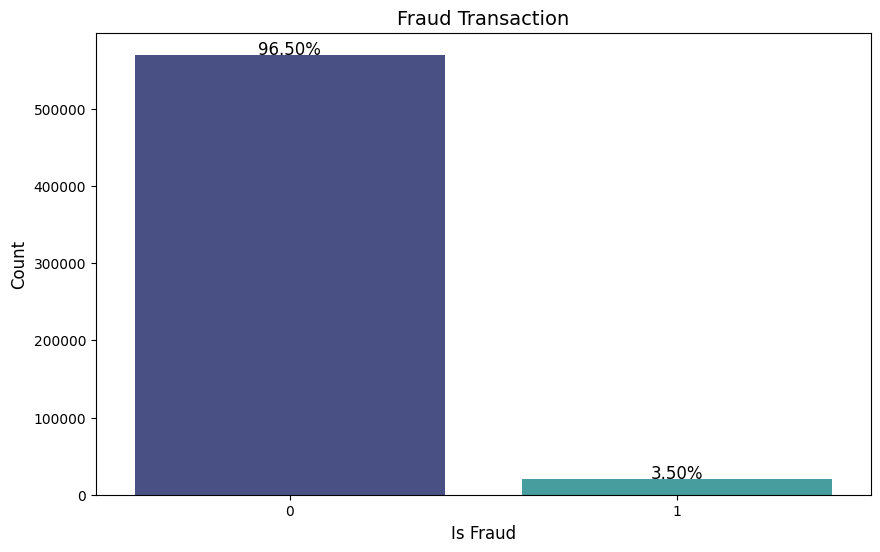

In [13]:
fig, ax = plt.subplots(figsize=(10, 6))

sns.countplot(x='isFraud', data=train_data_df, ax=ax, palette='mako', legend=False, hue='isFraud')

ax.set_title('Fraud Transaction', fontsize=14)
ax.set_xlabel('Is Fraud', fontsize=12)
ax.set_ylabel('Count', fontsize=12)

total = train_data_df.shape[0]
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x() + p.get_width() / 2.,
            height,
            f'{height / total * 100:.2f}%',
            ha='center', fontsize=12, color='black')

plt.show()

In [14]:
fraud_count = train_data_df['isFraud'].value_counts()
total_count = train_data_df.shape[0]
proportion_non_fraud = fraud_count[0] / total_count
proportion_fraud = fraud_count[1] / total_count

print(f'Proportion of Non-Fraud Transactions: {proportion_non_fraud * 100:.2f}%')
print(f'Proportion of Fraud Transactions: {proportion_fraud * 100:.2f}%')

Proportion of Non-Fraud Transactions: 96.50%
Proportion of Fraud Transactions: 3.50%


## TransactionDT analysis

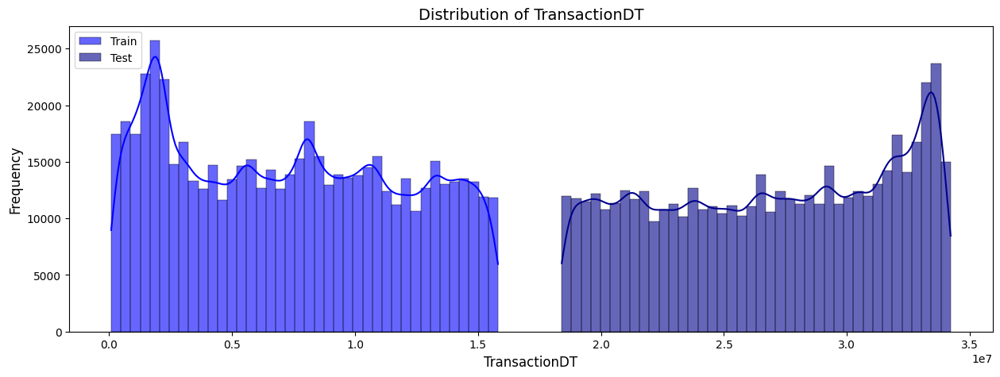

In [14]:
plt.figure(figsize=(15,5))
sns.histplot(train_data_df['TransactionDT'], kde=True, bins=40, color='blue', alpha=0.6, linewidth=0.3, label='Train')
sns.histplot(test_data_df['TransactionDT'], kde=True, bins=40, color='darkblue', alpha=0.6, linewidth=0.3, label='Test')
plt.title('Distribution of TransactionDT', fontsize=14)
plt.legend()
plt.xlabel('TransactionDT', fontsize=12)
plt.ylabel('Frequency', fontsize=12)
plt.show()

In [15]:
startdate = datetime.datetime.strptime('2017-12-01', '%Y-%m-%d')
train_data_df["TransactionDT_transformed"] = train_data_df['TransactionDT'].apply(lambda x: startdate + datetime.timedelta(seconds=x))
test_data_df["TransactionDT_transformed"] = test_data_df['TransactionDT'].apply(lambda x: startdate + datetime.timedelta(seconds=x))

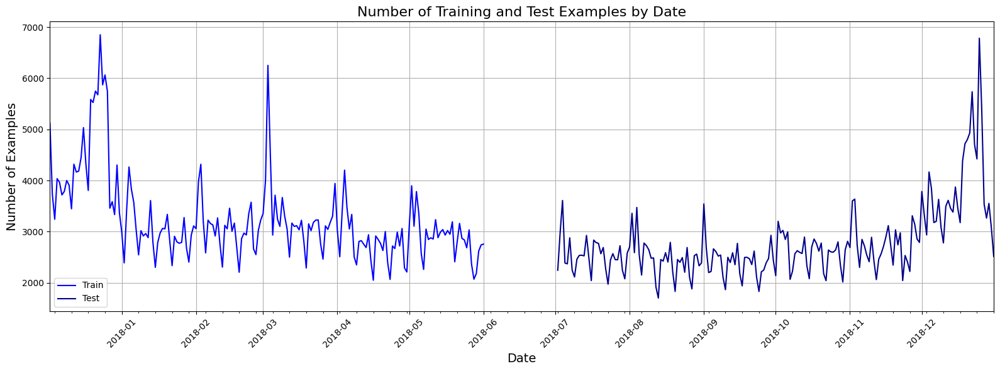

In [16]:
fig, ax = plt.subplots(1, 1, figsize=(16, 6))

train_counts = train_data_df["TransactionDT_transformed"].dt.floor('d').value_counts().sort_index()
train_counts.plot(ax=ax, color='blue', label='Train')

test_counts = test_data_df["TransactionDT_transformed"].dt.floor('d').value_counts().sort_index()
test_counts.plot(ax=ax, color='darkblue', label='Test')

ax.set_xlabel('Date', fontsize=14)
ax.set_ylabel('Number of Examples', fontsize=14)
ax.set_title('Number of Training and Test Examples by Date', fontsize=16)
ax.legend()

ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
plt.xticks(rotation=45)
fig.tight_layout()

ax.grid(True)
plt.show()

In [17]:
train_data_df["TransactionDT_day"] = train_data_df["TransactionDT_transformed"].dt.dayofweek
train_data_df["TransactionDT_hour"] = train_data_df["TransactionDT_transformed"].dt.hour

test_data_df["TransactionDT_day"] = test_data_df["TransactionDT_transformed"].dt.dayofweek
test_data_df["TransactionDT_hour"] = test_data_df["TransactionDT_transformed"].dt.hour

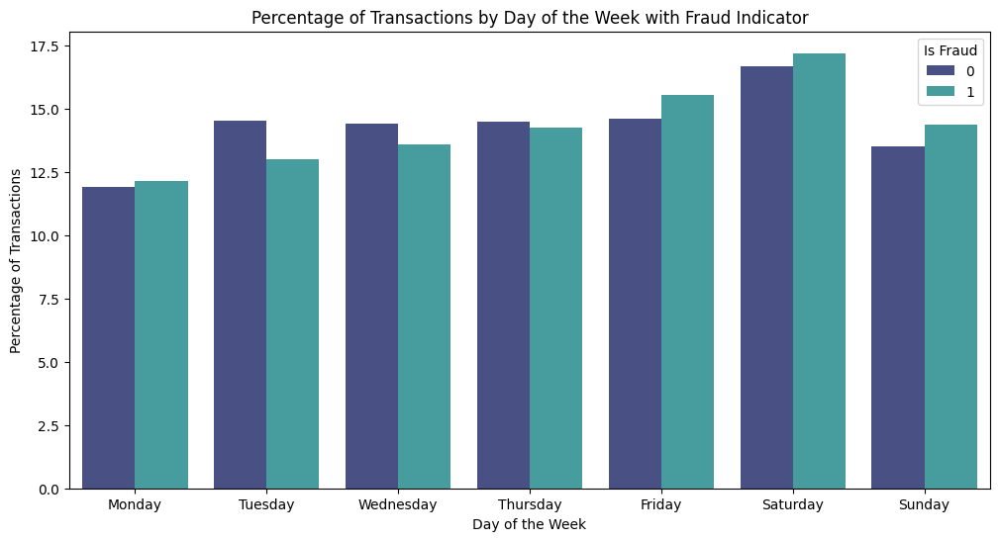

In [18]:
train_day = (train_data_df.groupby(['isFraud'])['TransactionDT_day']
             .value_counts(normalize=True)
             .rename('percentage')
             .mul(100)
             .reset_index()
             .sort_values('TransactionDT_day'))

plt.figure(figsize=(12, 6))
sns.barplot(data=train_day, x='TransactionDT_day', y='percentage', hue='isFraud', palette='mako')
plt.title('Percentage of Transactions by Day of the Week with Fraud Indicator')
plt.xlabel('Day of the Week')
plt.ylabel('Percentage of Transactions')
plt.legend(title='Is Fraud')
plt.xticks(ticks=[0, 1, 2, 3, 4, 5, 6], labels=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])
plt.show()

The plot shows that fraudulent transactions peak on Fridays and Saturdays, with Saturdays having the highest percentage of fraud. Non-fraudulent transactions are also high on these days, especially on Fridays. Mondays see the lowest activity for both types of transactions. The consistent rise in fraudulent activity from Thursday through Saturday suggests a pattern that could be leveraged to enhance fraud detection and resource allocation. More attention should be given to monitoring and preventing fraud during these high-risk days.

Tuesday and Wednesday have the lowest percentage of fraudulent transactions.

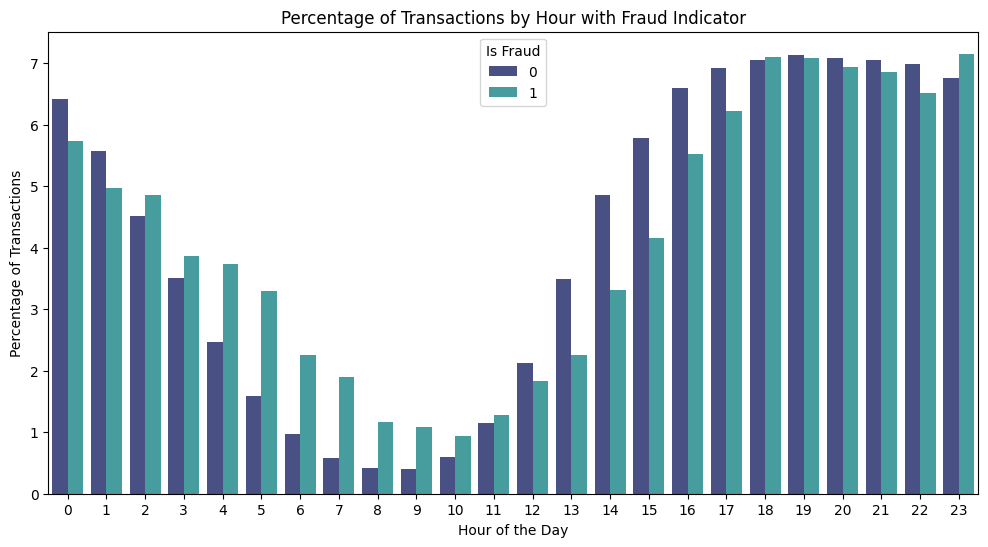

In [19]:
train_hour = (train_data_df.groupby(['isFraud'])['TransactionDT_hour']
              .value_counts(normalize=True)
              .rename('percentage')
              .mul(100)
              .reset_index()
              .sort_values('TransactionDT_hour'))

plt.figure(figsize=(12, 6))
sns.barplot(data=train_hour, x='TransactionDT_hour', y='percentage', hue='isFraud', palette='mako')
plt.title('Percentage of Transactions by Hour with Fraud Indicator')
plt.xlabel('Hour of the Day')
plt.ylabel('Percentage of Transactions')
plt.legend(title='Is Fraud')
plt.show()

Both non-fraudulent and fraudulent transactions are high, with a noticeable peak around midnight (23:00-00:00). Fraudulent transactions are slightly lower but follow a similar trend. There is a significant drop in both transaction types, with the lowest percentages observed between 04:00 and 10:00. Transaction volumes increase steadily from the afternoon, peaking again between 16:00 and 20:00, with fraudulent transactions showing a slight increase around 23:00. This suggests high-risk periods for fraud around midnight and late evening, while early morning hours are safer. Enhanced monitoring and strategic resource allocation during these peak hours can help mitigate fraud risk effectively.

## TransactionAmt (Transaction Amount) analysis

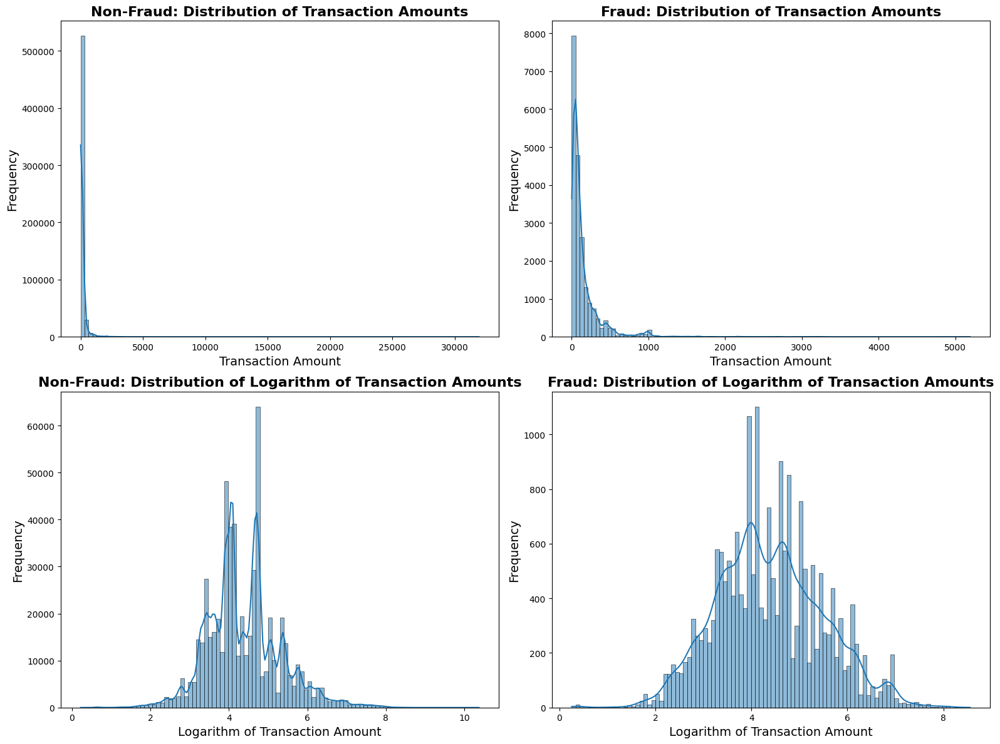

In [21]:
# Create a new column for the logarithm of TransactionAmt
train_data_df['LogTransactionAmt'] = np.log(train_data_df['TransactionAmt'] + 1)

# Filter data for fraud and non-fraud
non_fraud_data = train_data_df[train_data_df['isFraud'] == 0]
fraud_data = train_data_df[train_data_df['isFraud'] == 1]

# Create the subplots
fig, axes = plt.subplots(2, 2, figsize=(16, 12))

# Plot the original TransactionAmt for non-fraud
sns.histplot(data=non_fraud_data, x='TransactionAmt', bins=100, kde=True, ax=axes[0, 0])
axes[0, 0].set_title('Non-Fraud: Distribution of Transaction Amounts', fontsize=16, fontweight='bold')
axes[0, 0].set_xlabel('Transaction Amount', fontsize=14)
axes[0, 0].set_ylabel('Frequency', fontsize=14)

# Plot the original TransactionAmt for fraud
sns.histplot(data=fraud_data, x='TransactionAmt', bins=100, kde=True, ax=axes[0, 1])
axes[0, 1].set_title('Fraud: Distribution of Transaction Amounts', fontsize=16, fontweight='bold')
axes[0, 1].set_xlabel('Transaction Amount', fontsize=14)
axes[0, 1].set_ylabel('Frequency', fontsize=14)

# Plot the logarithm of TransactionAmt for non-fraud
sns.histplot(data=non_fraud_data, x='LogTransactionAmt', bins=100, kde=True, ax=axes[1, 0])
axes[1, 0].set_title('Non-Fraud: Distribution of Logarithm of Transaction Amounts', fontsize=16, fontweight='bold')
axes[1, 0].set_xlabel('Logarithm of Transaction Amount', fontsize=14)
axes[1, 0].set_ylabel('Frequency', fontsize=14)

# Plot the logarithm of TransactionAmt for fraud
sns.histplot(data=fraud_data, x='LogTransactionAmt', bins=100, kde=True, ax=axes[1, 1])
axes[1, 1].set_title('Fraud: Distribution of Logarithm of Transaction Amounts', fontsize=16, fontweight='bold')
axes[1, 1].set_xlabel('Logarithm of Transaction Amount', fontsize=14)
axes[1, 1].set_ylabel('Frequency', fontsize=14)

# Adjust layout
plt.tight_layout()
plt.show()

/tmp/ipykernel_9311/817165668.py:8: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(['Non-Fraud', 'Fraud'])


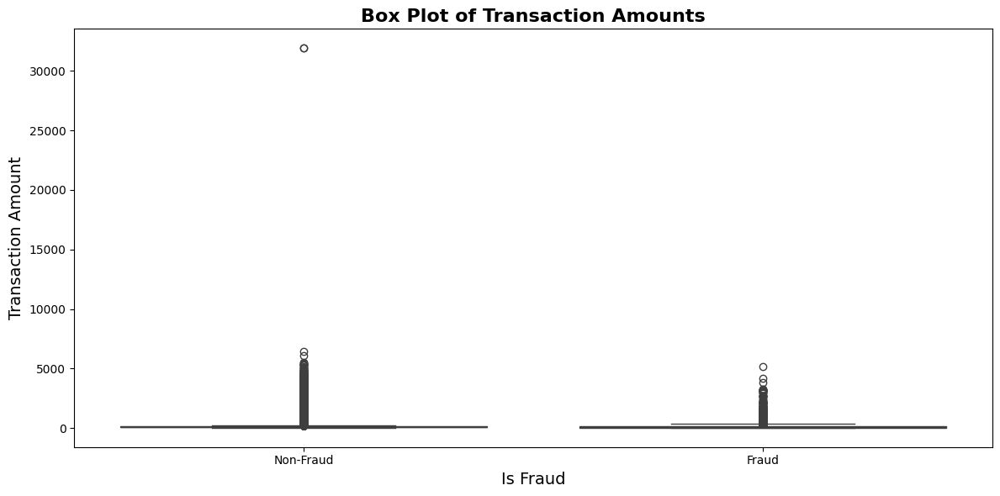

In [22]:
fig, ax = plt.subplots(figsize=(12, 6))

# Box plot of the original TransactionAmt for non-fraud and fraud
sns.boxplot(data=train_data_df, x='isFraud', y='TransactionAmt', ax=ax)
ax.set_title('Box Plot of Transaction Amounts', fontsize=16, fontweight='bold')
ax.set_xlabel('Is Fraud', fontsize=14)
ax.set_ylabel('Transaction Amount', fontsize=14)
ax.set_xticklabels(['Non-Fraud', 'Fraud'])

# Adjust layout
plt.tight_layout()
plt.show()

In [24]:
train_data_df = train_data_df[train_data_df['TransactionAmt']<10000]


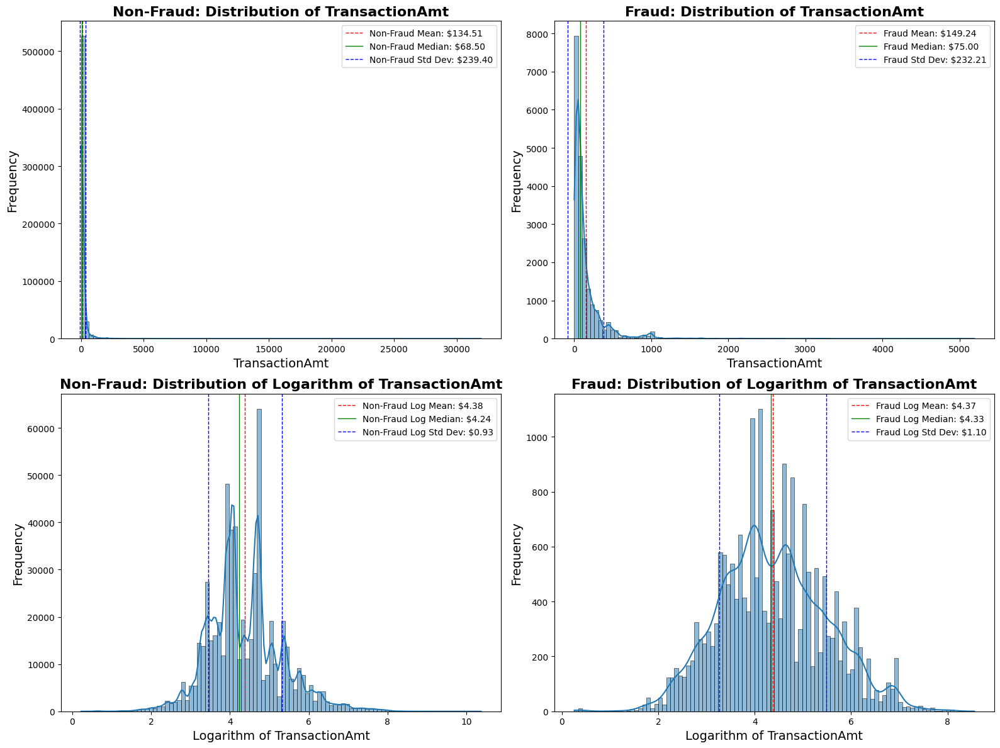

In [7]:
def add_stat_lines(ax, data, column, label_prefix):
    mean_val = data[column].mean()
    median_val = data[column].median()
    std_val = data[column].std()
    
    ax.axvline(mean_val, color='r', linestyle='--', linewidth=1, label=f'{label_prefix} Mean: ${mean_val:.2f}')
    ax.axvline(median_val, color='g', linestyle='-', linewidth=1, label=f'{label_prefix} Median: ${median_val:.2f}')
    ax.axvline(mean_val + std_val, color='b', linestyle='--', linewidth=1, label=f'{label_prefix} Std Dev: ${std_val:.2f}')
    ax.axvline(mean_val - std_val, color='b', linestyle='--', linewidth=1)
    ax.legend()

def plot_histograms(data, column, log_column, title, axes, row, col):
    sns.histplot(data=data, x=column, bins=100, kde=True, ax=axes[row, col])
    axes[row, col].set_title(f'{title}: Distribution of {column}', fontsize=16, fontweight='bold')
    axes[row, col].set_xlabel(column, fontsize=14)
    axes[row, col].set_ylabel('Frequency', fontsize=14)
    add_stat_lines(axes[row, col], data, column, title)
    
    sns.histplot(data=data, x=log_column, bins=100, kde=True, ax=axes[row + 1, col])
    axes[row + 1, col].set_title(f'{title}: Distribution of Logarithm of {column}', fontsize=16, fontweight='bold')
    axes[row + 1, col].set_xlabel(f'Logarithm of {column}', fontsize=14)
    axes[row + 1, col].set_ylabel('Frequency', fontsize=14)
    add_stat_lines(axes[row + 1, col], data, log_column, f'{title} Log')

# Create a new column for the logarithm of TransactionAmt
train_data_df['LogTransactionAmt'] = np.log(train_data_df['TransactionAmt'] + 1)

# Filter data for fraud and non-fraud
non_fraud_data = train_data_df[train_data_df['isFraud'] == 0]
fraud_data = train_data_df[train_data_df['isFraud'] == 1]

# Create the subplots
fig, axes = plt.subplots(2, 2, figsize=(16, 12))

# Plot for non-fraud and fraud data
plot_histograms(non_fraud_data, 'TransactionAmt', 'LogTransactionAmt', 'Non-Fraud', axes, 0, 0)
plot_histograms(fraud_data, 'TransactionAmt', 'LogTransactionAmt', 'Fraud', axes, 0, 1)

# Adjust layout
plt.tight_layout()
plt.show()

The distribution is heavily right-skewed, with most transactions clustering at lower amounts. This suggests that a large proportion of transactions are relatively small. The mean and median are relatively close, indicating that while there are some higher transaction amounts, they do not drastically shift the average. Finally, the standard deviation is quite large relative to the mean and median, indicating significant variability in transaction amounts. 

/home/chris/tp_final_amq1_fraud_dataset/venv/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


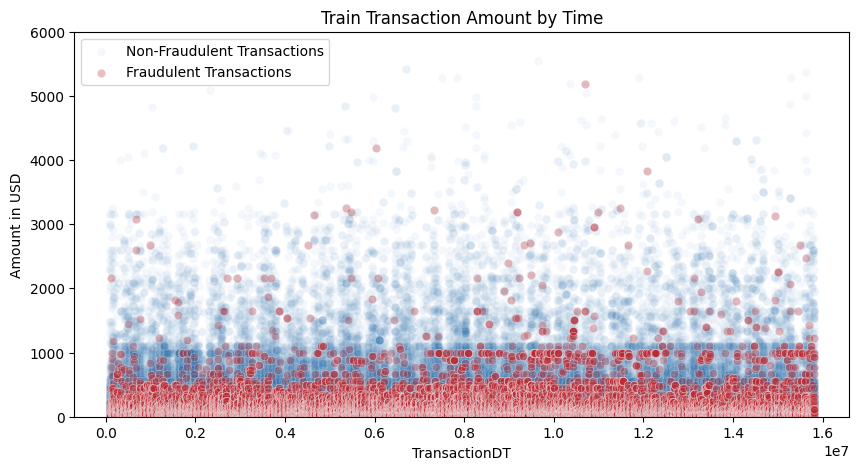

In [48]:
cmap = sns.color_palette("RdBu", n_colors=7)

fig, ax = plt.subplots(figsize=(10, 5))

sns.scatterplot(
    x=train_data_df['TransactionDT'],
    y=train_data_df['TransactionAmt'],
    alpha=0.05,
    color=cmap[6],
    label='Non-Fraudulent Transactions',
    ax=ax
)

ax.set_title("Train Transaction Amount by Time")
ax.set_xlabel("TransactionDT")
ax.set_ylabel("Amount in USD")
ax.set_ylim(0, 6000)

fraud_entries = train_data_df.loc[train_data_df['isFraud'] == 1]

sns.scatterplot(
    x=fraud_entries['TransactionDT'],
    y=fraud_entries['TransactionAmt'],
    alpha=0.3,
    color=cmap[0],
    label='Fraudulent Transactions',
    ax=ax
)

ax.legend()
plt.show()


## ProductCD analysis

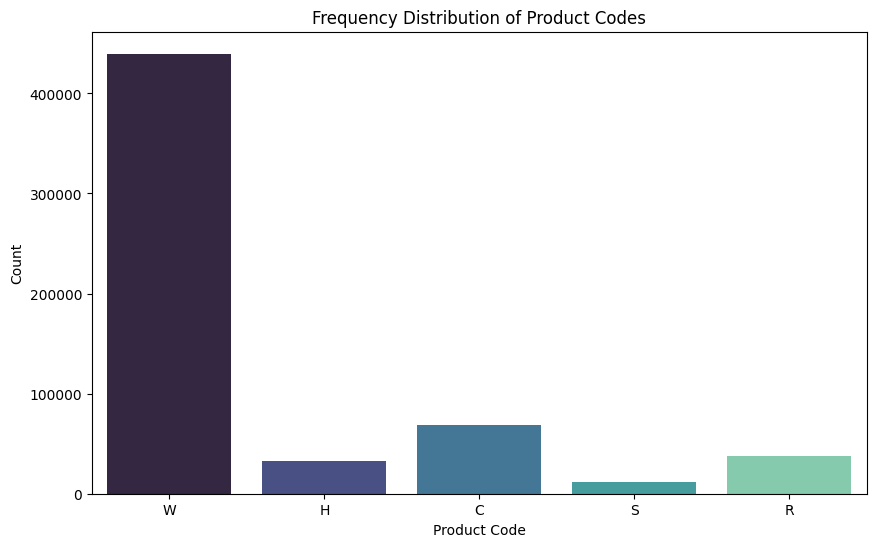

In [52]:
plt.figure(figsize=(10, 6))
sns.countplot(data=train_data_df, x='ProductCD', palette='mako', legend=False, hue='ProductCD')
plt.title('Frequency Distribution of Product Codes')
plt.xlabel('Product Code')
plt.ylabel('Count')
plt.show()


The above plots show that the most common product code is W, followed by C, R, H, and finally S. The cardinality of the product code is relatively low, with only five unique values. This suggests that the product code is a categorical variable with a limited number of categories. One-hot encoding or label encoding could be used to convert this variable into a format suitable for machine learning models.

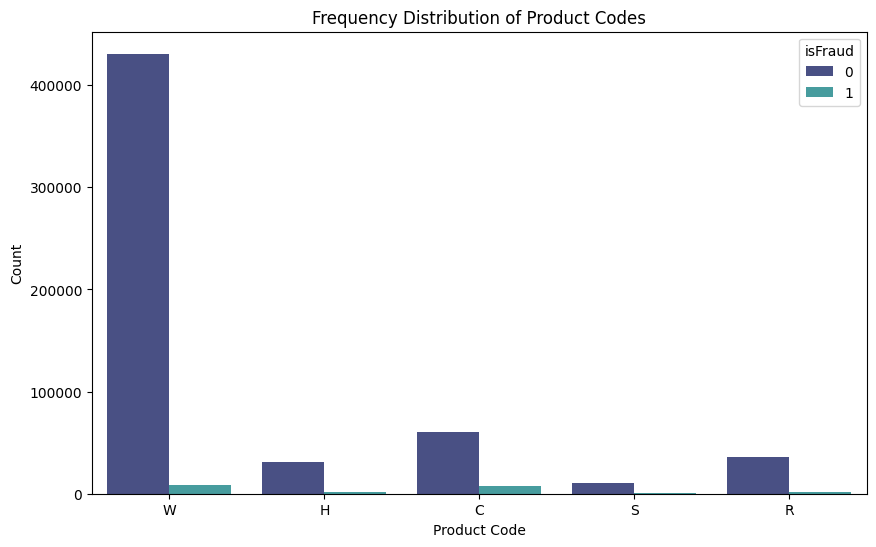

In [55]:
plt.figure(figsize=(10, 6))
sns.countplot(data=train_data_df, x='ProductCD', palette='mako', hue='isFraud')
plt.title('Frequency Distribution of Product Codes')
plt.xlabel('Product Code')
plt.ylabel('Count')
plt.show()

The plot suggests that product code 'W' is the most prevalent in the dataset, which could indicate its popularity or frequent use in transactions. Fraudulent transactions are present on 'W', 'C', with fewer occurrences on 'H', 'R', and 'S'. This suggests that certain product codes may be more susceptible to fraud than others; since, we know the dataset is imbalanced, we should consider this when interpreting the results.

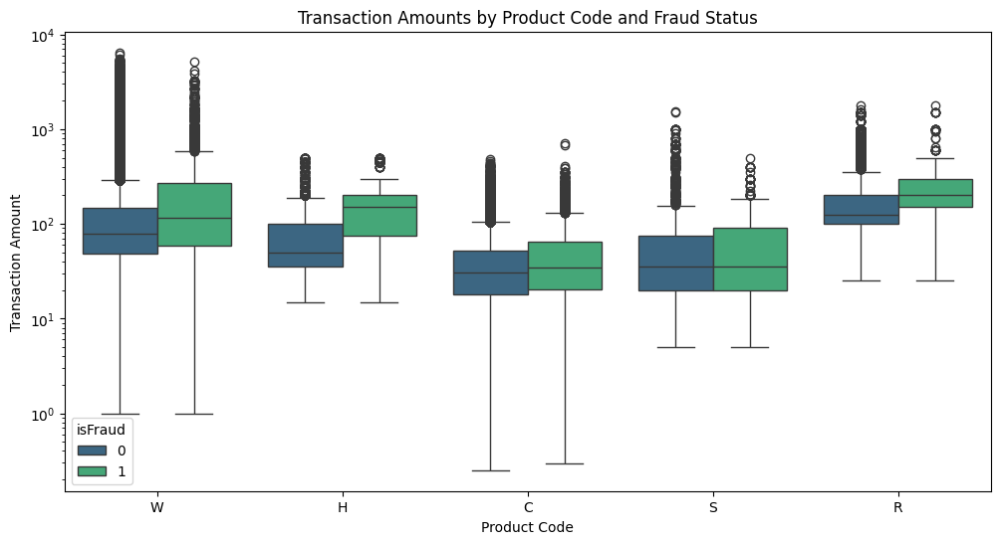

In [56]:
plt.figure(figsize=(12, 6))
sns.boxplot(data=train_data_df, x='ProductCD', y='TransactionAmt', hue='isFraud', palette='viridis')
plt.title('Transaction Amounts by Product Code and Fraud Status')
plt.xlabel('Product Code')
plt.ylabel('Transaction Amount')
plt.yscale('log')
plt.show()



The plot reveals that fraudulent transactions generally have higher median amounts compared to non-fraudulent transactions across all product codes. This trend is particularly noticeable for product codes 'W', 'C', and 'R'. This analysis suggests that higher transaction amounts are associated with an increased likelihood of fraud, making it a key factor to consider for fraud detection.

## Card features analysis

The dataset description indicates that the card features are categorical variables. However `card1`, `card2`, `card3`, `card5` are encoded as numerical variables. Since we do not have additional information on the encoding, we will treat them as numerical variables that may have meaning on card features hidden for privacy reasons. 

In [57]:
train_data_df[['card1', 'card2', 'card3', 'card4', 'card5', 'card6']]

,card1,card2,card3,card4,card5,card6
0,13926,NaN,150.0,discover,142.0,credit
1,2755,404.0,150.0,mastercard,102.0,credit
2,4663,490.0,150.0,visa,166.0,debit
3,18132,567.0,150.0,mastercard,117.0,debit
4,4497,514.0,150.0,mastercard,102.0,credit
...,...,...,...,...,...,...
590535,6550,NaN,150.0,visa,226.0,debit
590536,10444,225.0,150.0,mastercard,224.0,debit
590537,12037,595.0,150.0,mastercard,224.0,debit
590538,7826,481.0,150.0,mastercard,224.0,debit


In [65]:
summary = train_data_df[['card1', 'card2', 'card3', 'card5']].describe()
missing_values = train_data_df[['card1', 'card2', 'card3', 'card5']].isnull().sum()
summary.loc['missing'] = missing_values
summary

,card1,card2,card3,card5
count,590538.000000,581605.000000,588973.000000,586279.000000
mean,9898.713741,362.554968,153.194936,199.279229
std,4901.165273,157.793268,11.336462,41.244132
min,1000.000000,100.000000,100.000000,100.000000
25%,6019.000000,214.000000,150.000000,166.000000
50%,9678.000000,361.000000,150.000000,226.000000
75%,14182.750000,512.000000,150.000000,226.000000
max,18396.000000,600.000000,231.000000,237.000000
missing,0.000000,8933.000000,1565.000000,4259.000000


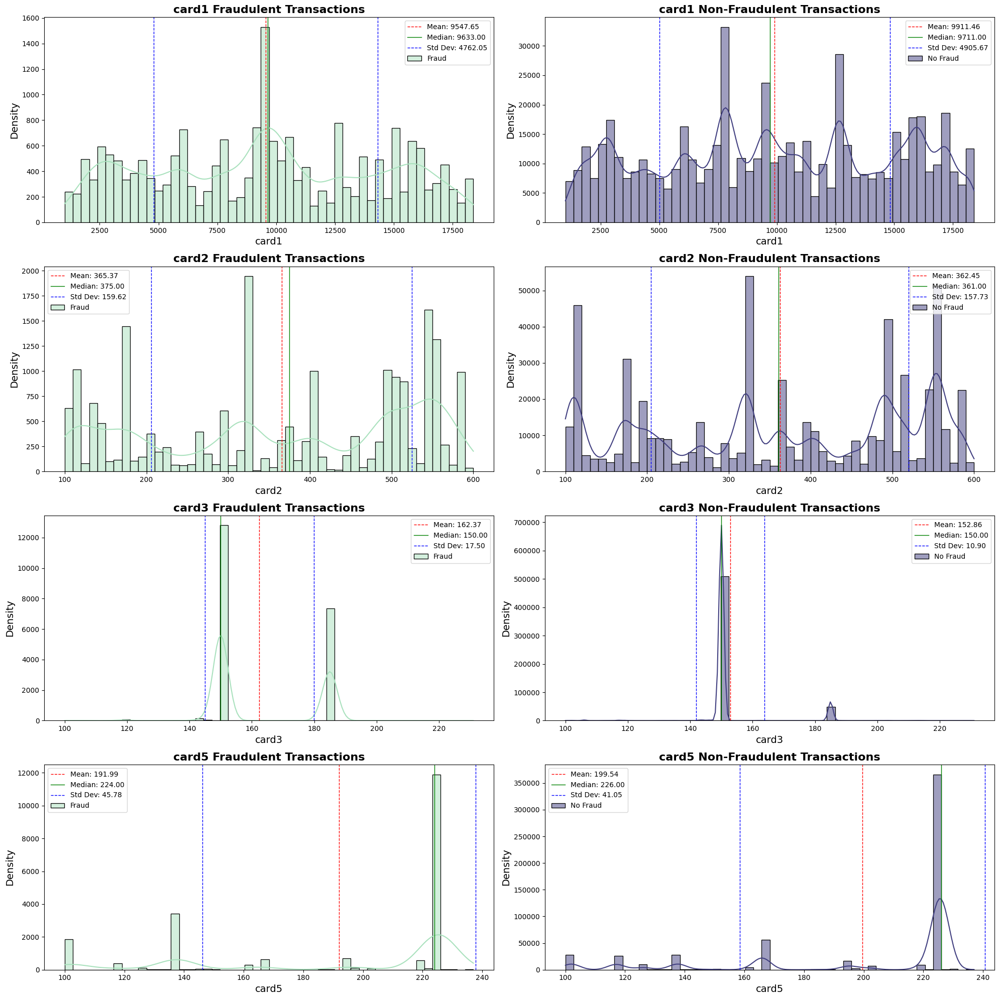

In [7]:
sns.set_palette('mako')

fig, axes = plt.subplots(4, 2, figsize=(20, 20))

cards_col = ['card1', 'card2', 'card3', 'card5']

def add_stat_lines(ax, data, column):
    mean_val = data[column].mean()
    median_val = data[column].median()
    std_val = data[column].std()
    
    ax.axvline(mean_val, color='r', linestyle='--', linewidth=1, label=f'Mean: {mean_val:.2f}')
    ax.axvline(median_val, color='g', linestyle='-', linewidth=1, label=f'Median: {median_val:.2f}')
    ax.axvline(mean_val + std_val, color='b', linestyle='--', linewidth=1, label=f'Std Dev: {std_val:.2f}')
    ax.axvline(mean_val - std_val, color='b', linestyle='--', linewidth=1)
    ax.legend()

for i, card in enumerate(cards_col):
    sns.histplot(
        data=train_data_df[train_data_df['isFraud'] == 1],
        x=card,
        bins=50,
        kde=True,
        ax=axes[i, 0],
        color=sns.color_palette('mako', as_cmap=True)(0.9),
        label='Fraud'
    )
    add_stat_lines(axes[i, 0], train_data_df[train_data_df['isFraud'] == 1], card)
    axes[i, 0].set_title(f'{card} Fraudulent Transactions', fontsize=16, fontweight='bold')
    axes[i, 0].set_xlabel(card, fontsize=14)
    axes[i, 0].set_ylabel('Density', fontsize=14)

    sns.histplot(
        data=train_data_df[train_data_df['isFraud'] == 0],
        x=card,
        bins=50,
        kde=True,
        ax=axes[i, 1],
        color=sns.color_palette('mako', as_cmap=True)(0.3),
        label='No Fraud'
    )
    add_stat_lines(axes[i, 1], train_data_df[train_data_df['isFraud'] == 0], card)
    axes[i, 1].set_title(f'{card} Non-Fraudulent Transactions', fontsize=16, fontweight='bold')
    axes[i, 1].set_xlabel(card, fontsize=14)
    axes[i, 1].set_ylabel('Density', fontsize=14)

plt.tight_layout()
plt.show()

Variables `card4` and `card6` are categorical variables that represent the card issuer and card type, respectively. These variables have a low cardinality, with only four unique values for `card4` and three unique values for `card6`. This suggests that one-hot encoding or label encoding could be used.

In [8]:
def replaceCard(value):
    if pd.isna(value):
        return value
    if value in ['debit or credit', 'charge card']:
        return 'debit'
    else:
        return value

In [9]:
train_data_df['card6'] = train_data_df['card6'].apply(replaceCard)
train_data_df['card6'] = train_data_df['card6'].apply(replaceCard)

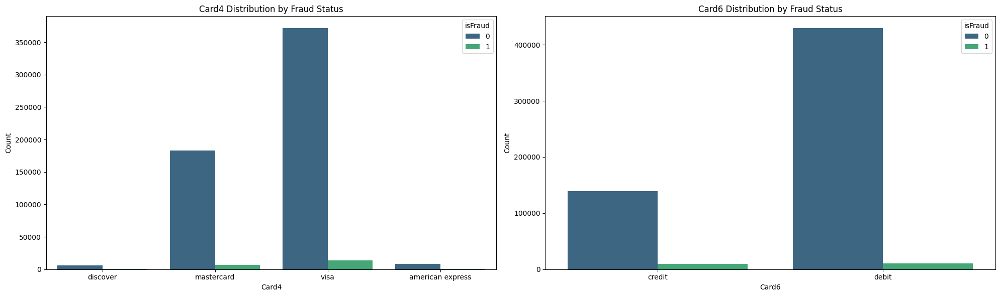

In [10]:
fig, axes = plt.subplots(1, 2, figsize=(20, 6))

sns.countplot(ax=axes[0], data=train_data_df, x='card4', hue='isFraud', palette='viridis')
axes[0].set_title('Card4 Distribution by Fraud Status')
axes[0].set_xlabel('Card4')
axes[0].set_ylabel('Count')

sns.countplot(ax=axes[1], data=train_data_df, x='card6', hue='isFraud', palette='viridis')
axes[1].set_title('Card6 Distribution by Fraud Status')
axes[1].set_xlabel('Card6')
axes[1].set_ylabel('Count')

plt.tight_layout()
plt.show()

From the `card4` plot we can see that the most common card type is visa, followed by mastercard, american express and discover. The plot also shows that visa and mastercard have the most noticeable fraudulent transactions, with visa having the highest number of fraudulent transactions. This suggests that visa and mastercard are more susceptible to fraud than american express and discover, assuming the imbalanced dataset.

For the `card6` plot, we can see that the most common card type is debit. Both credit and debit cards have a similar distribution of fraudulent transactions.

In [12]:
print(list(train_data_df.columns))

['TransactionID', 'isFraud', 'TransactionDT', 'TransactionAmt', 'ProductCD', 'card1', 'card2', 'card3', 'card4', 'card5', 'card6', 'addr1', 'addr2', 'dist1', 'dist2', 'P_emaildomain', 'R_emaildomain', 'C1', 'C2', 'C3', 'C4', 'C5', 'C6', 'C7', 'C8', 'C9', 'C10', 'C11', 'C12', 'C13', 'C14', 'D1', 'D2', 'D3', 'D4', 'D5', 'D6', 'D7', 'D8', 'D9', 'D10', 'D11', 'D12', 'D13', 'D14', 'D15', 'M1', 'M2', 'M3', 'M4', 'M5', 'M6', 'M7', 'M8', 'M9', 'V1', 'V2', 'V3', 'V4', 'V5', 'V6', 'V7', 'V8', 'V9', 'V10', 'V11', 'V12', 'V13', 'V14', 'V15', 'V16', 'V17', 'V18', 'V19', 'V20', 'V21', 'V22', 'V23', 'V24', 'V25', 'V26', 'V27', 'V28', 'V29', 'V30', 'V31', 'V32', 'V33', 'V34', 'V35', 'V36', 'V37', 'V38', 'V39', 'V40', 'V41', 'V42', 'V43', 'V44', 'V45', 'V46', 'V47', 'V48', 'V49', 'V50', 'V51', 'V52', 'V53', 'V54', 'V55', 'V56', 'V57', 'V58', 'V59', 'V60', 'V61', 'V62', 'V63', 'V64', 'V65', 'V66', 'V67', 'V68', 'V69', 'V70', 'V71', 'V72', 'V73', 'V74', 'V75', 'V76', 'V77', 'V78', 'V79', 'V80', 'V81', 'V

## Addr data analysis

The `addr1` and `addr2` features are categorical variables represented as float64 numerical variables, this indicates that the values are encoded, surely for privacy reasons. Since no more information is provided, we will treat them as numerical features.

In [13]:
train_data_df[['addr1', 'addr2']]

,addr1,addr2
0,315.0,87.0
1,325.0,87.0
2,330.0,87.0
3,476.0,87.0
4,420.0,87.0
...,...,...
590535,272.0,87.0
590536,204.0,87.0
590537,231.0,87.0
590538,387.0,87.0


In [14]:
summary = train_data_df[['addr1', 'addr2']].describe()
missing_values = train_data_df[['addr1', 'addr2']].isnull().sum()
summary.loc['missing'] = missing_values
summary

,addr1,addr2
count,524834.000000,524834.000000
mean,290.733794,86.800630
std,101.741072,2.690623
min,100.000000,10.000000
25%,204.000000,87.000000
50%,299.000000,87.000000
75%,330.000000,87.000000
max,540.000000,102.000000
missing,65706.000000,65706.000000


In [20]:
# Calculate the percentage of data in the top 35 unique values for addr1
addr1_top35_percentage = (train_data_df['addr1'].value_counts().head(35) / train_data_df['addr1'].shape[0] * 100).sum()
print(f"Top 35 addr1 values cover {addr1_top35_percentage:.2f}% of the data")

# Calculate the percentage of data in the top 5 unique values for addr2
addr2_top5_percentage = (train_data_df['addr2'].value_counts().head(5)  / train_data_df['addr2'].shape[0] * 100).sum()
print(f"Top 5 addr2 values cover {addr2_top5_percentage:.2f}% of the data")


Top 35 addr1 values cover 82.91% of the data
Top 5 addr2 values cover 88.80% of the data


In [22]:
# Group addr1 values with less than or equal to 5000 occurrences into "Others"
train_data_df.loc[train_data_df.addr1.isin(train_data_df.addr1.value_counts()[train_data_df.addr1.value_counts() <= 5000].index), 'addr1'] = "Others"

# Group addr2 values with less than or equal to 50 occurrences into "Others"
train_data_df.loc[train_data_df.addr2.isin(train_data_df.addr2.value_counts()[train_data_df.addr2.value_counts() <= 50].index), 'addr2'] = "Others"

/tmp/ipykernel_3011/2892986422.py:2: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Others' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  train_data_df.loc[train_data_df.addr1.isin(train_data_df.addr1.value_counts()[train_data_df.addr1.value_counts() <= 5000].index), 'addr1'] = "Others"
/tmp/ipykernel_3011/2892986422.py:5: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value 'Others' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  train_data_df.loc[train_data_df.addr2.isin(train_data_df.addr2.value_counts()[train_data_df.addr2.value_counts() <= 50].index), 'addr2'] = "Others"


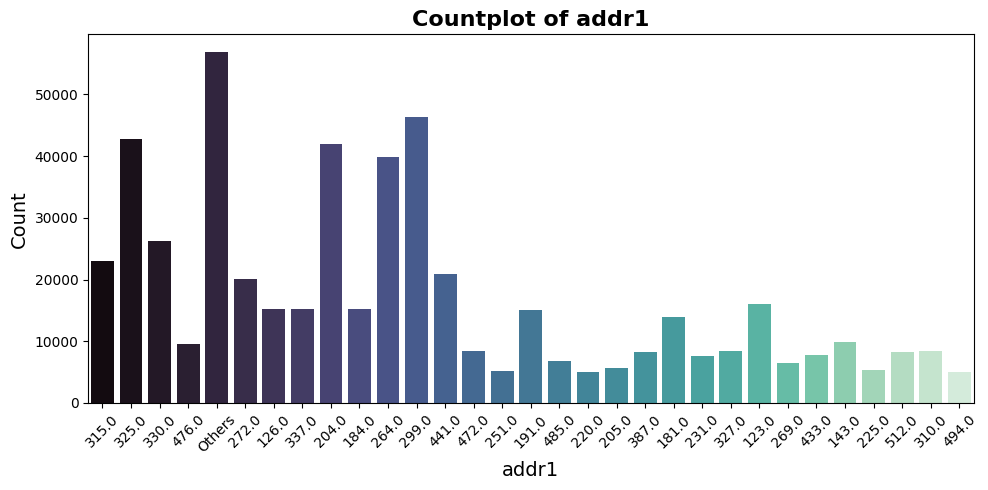

In [25]:
plt.figure(figsize=(10, 5))
sns.countplot(data=train_data_df, x='addr1', palette='mako', legend=False, hue='addr1')
plt.title('Countplot of addr1', fontsize=16, fontweight='bold')
plt.xlabel('addr1', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

The plot above show a high cardinality for the `addr1` feature. Where the values 299, 325, 204 and 264 are the most common, considering that the most of the values are concentrated in the others category. 

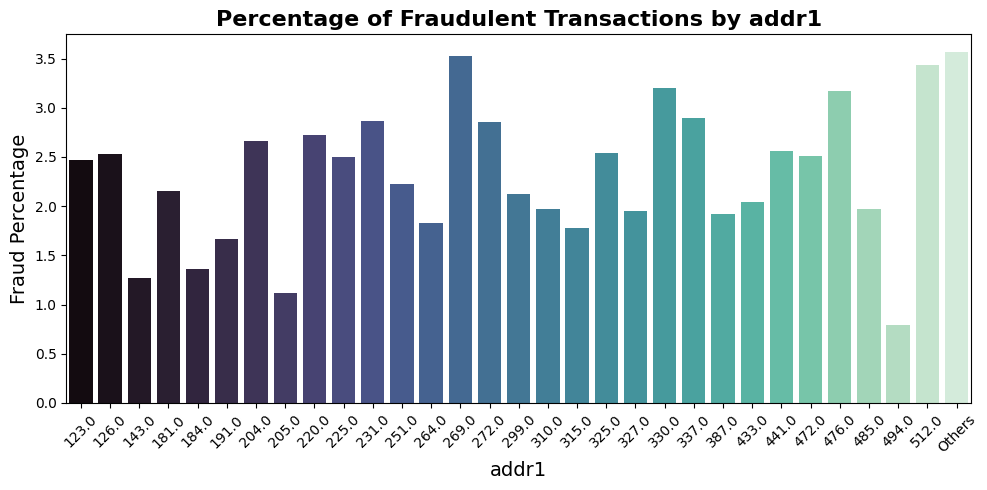

In [32]:
fraud_percentage = train_data_df.groupby('addr1')['isFraud'].mean() * 100
fraud_percentage = fraud_percentage.reset_index().rename(columns={'isFraud': 'Fraud Percentage'})

plt.figure(figsize=(10, 5))
sns.barplot(data=fraud_percentage, x='addr1', y='Fraud Percentage', palette='mako', legend=False, hue='addr1')
plt.title('Percentage of Fraudulent Transactions by addr1', fontsize=16, fontweight='bold')
plt.xlabel('addr1', fontsize=14)
plt.ylabel('Fraud Percentage', fontsize=14)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

From the plot above, we can see that the categories with a larger proportion of fraudulent transactions are 269, 330, 476, 512, and others. This suggests that transactions associated with these address categories may be more susceptible to fraud than others

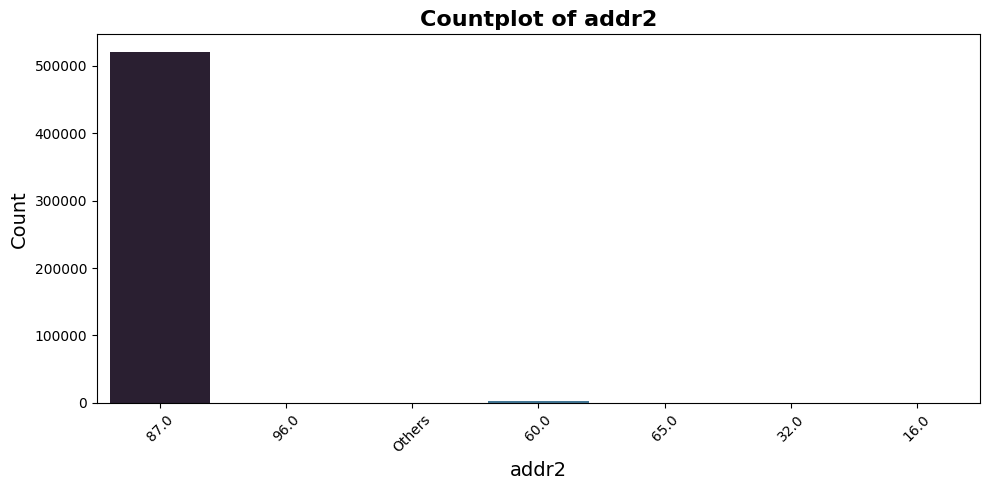

In [29]:
plt.figure(figsize=(10, 5))
sns.countplot(data=train_data_df, x='addr2', palette='mako', legend=False, hue='addr2')
plt.title('Countplot of addr2', fontsize=16, fontweight='bold')
plt.xlabel('addr2', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

The `addr2` category presents a lower cardinality compared to `addr1`. The most common values are 87, other categories have very few values.

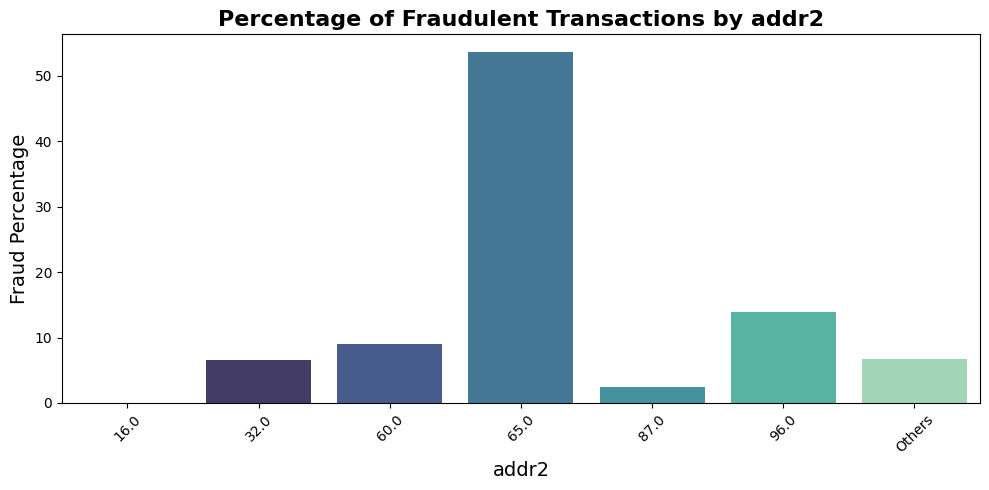

In [33]:
fraud_percentage = train_data_df.groupby('addr2')['isFraud'].mean() * 100
fraud_percentage = fraud_percentage.reset_index().rename(columns={'isFraud': 'Fraud Percentage'})

plt.figure(figsize=(10, 5))
sns.barplot(data=fraud_percentage, x='addr2', y='Fraud Percentage', palette='mako', legend=False, hue='addr2')
plt.title('Percentage of Fraudulent Transactions by addr2', fontsize=16, fontweight='bold')
plt.xlabel('addr2', fontsize=14)
plt.ylabel('Fraud Percentage', fontsize=14)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

Analyzing the proportion of fraudulent transactions, we can see that the categories with the highest proportion of fraudulent transactions are 65, followed by 96 and others. Contrasting in this case that the most common categories have a lower proportion of fraudulent transactions.

## P_emaildomain and R_emaildomain

The `P_emaildomain` feature represents the email domain of the purchaser, while the `R_emaildomain` feature represents the email domain of the recipient. 

In [13]:
unique_values = train_data_df['P_emaildomain'].unique()
print(f"{len(unique_values)} unique values in P_emaildomain: \n{unique_values}")

60 unique values in P_emaildomain: 
[nan 'gmail.com' 'outlook.com' 'yahoo.com' 'mail.com' 'anonymous.com'
 'hotmail.com' 'verizon.net' 'aol.com' 'me.com' 'comcast.net'
 'optonline.net' 'cox.net' 'charter.net' 'rocketmail.com' 'prodigy.net.mx'
 'embarqmail.com' 'icloud.com' 'live.com.mx' 'gmail' 'live.com' 'att.net'
 'juno.com' 'ymail.com' 'sbcglobal.net' 'bellsouth.net' 'msn.com' 'q.com'
 'yahoo.com.mx' 'centurylink.net' 'servicios-ta.com' 'earthlink.net'
 'hotmail.es' 'cfl.rr.com' 'roadrunner.com' 'netzero.net' 'gmx.de'
 'suddenlink.net' 'frontiernet.net' 'windstream.net' 'frontier.com'
 'outlook.es' 'mac.com' 'netzero.com' 'aim.com' 'web.de' 'twc.com'
 'cableone.net' 'yahoo.fr' 'yahoo.de' 'yahoo.es' 'sc.rr.com' 'ptd.net'
 'live.fr' 'yahoo.co.uk' 'hotmail.fr' 'hotmail.de' 'hotmail.co.uk'
 'protonmail.com' 'yahoo.co.jp']


In [11]:
unique_values = train_data_df['R_emaildomain'].unique()
print(f"{len(unique_values)} unique values in R_emaildomain: \n{unique_values}")

61 Unique values in R_emaildomain: 
[nan 'gmail.com' 'hotmail.com' 'outlook.com' 'anonymous.com' 'charter.net'
 'prodigy.net.mx' 'comcast.net' 'live.com.mx' 'icloud.com' 'yahoo.com'
 'aol.com' 'juno.com' 'att.net' 'verizon.net' 'yahoo.com.mx'
 'bellsouth.net' 'servicios-ta.com' 'ymail.com' 'hotmail.es' 'msn.com'
 'optonline.net' 'live.com' 'gmx.de' 'aim.com' 'mail.com' 'me.com'
 'outlook.es' 'cox.net' 'earthlink.net' 'embarqmail.com' 'web.de'
 'sbcglobal.net' 'scranton.edu' 'mac.com' 'twc.com' 'roadrunner.com'
 'yahoo.fr' 'yahoo.de' 'yahoo.es' 'frontiernet.net' 'gmail' 'live.fr'
 'q.com' 'yahoo.co.uk' 'windstream.net' 'suddenlink.net' 'hotmail.fr'
 'ptd.net' 'hotmail.de' 'frontier.com' 'cfl.rr.com' 'hotmail.co.uk'
 'netzero.com' 'netzero.net' 'yahoo.co.jp' 'rocketmail.com'
 'centurylink.net' 'protonmail.com' 'cableone.net' 'sc.rr.com']


In [23]:
def group_email_domain(df):
    # Define the mapping of email domains to service providers
    provider_mapping = {
        'Google Mail': ['gmail.com', 'gmail'],
        'Yahoo Mail': ['yahoo.com', 'ymail.com', 'yahoo.com.mx', 'yahoo.co.jp', 'yahoo.fr',
                       'yahoo.co.uk', 'yahoo.es', 'yahoo.de'],
        'Microsoft Mail': ['hotmail.com', 'outlook.com', 'msn.com', 'live.com', 'live.com.mx',
                           'outlook.es', 'hotmail.fr', 'hotmail.co.uk', 'live.fr', 'hotmail.es',
                           'hotmail.de'],
        'Apple Mail': ['icloud.com', 'me.com', 'mac.com']
    }

    for email in ['P_emaildomain', 'R_emaildomain']:
        for provider, domains in provider_mapping.items():
            df.loc[df[email].isin(domains), email] = provider

        domain_counts = df[email].value_counts()
        less_frequent_domains = domain_counts[domain_counts <= 1000].index
        df.loc[df[email].isin(less_frequent_domains), email] = 'Others'

    return df

In [24]:
group_email_domain(train_data_df)

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987000,0,86400,68.50,W,13926,NaN,150.0,discover,142.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.00,W,2755,404.0,150.0,mastercard,102.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2987002,0,86469,59.00,W,4663,490.0,150.0,visa,166.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2987003,0,86499,50.00,W,18132,567.0,150.0,mastercard,117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2987004,0,86506,50.00,H,4497,514.0,150.0,mastercard,102.0,...,samsung browser 6.2,32.0,2220x1080,match_status:2,T,F,T,T,mobile,SAMSUNG SM-G892A Build/NRD90M
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
590535,3577535,0,15811047,49.00,W,6550,NaN,150.0,visa,226.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
590536,3577536,0,15811049,39.50,W,10444,225.0,150.0,mastercard,224.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
590537,3577537,0,15811079,30.95,W,12037,595.0,150.0,mastercard,224.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
590538,3577538,0,15811088,117.00,W,7826,481.0,150.0,mastercard,224.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


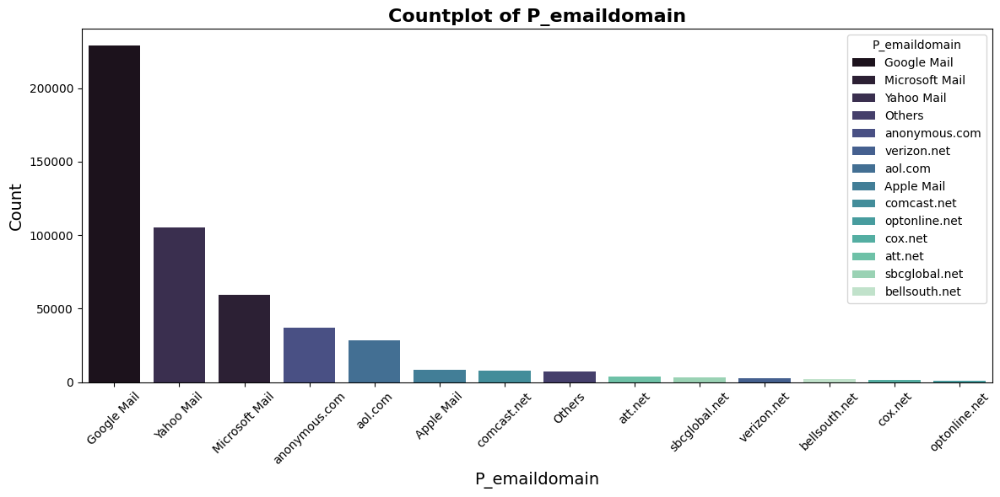

In [26]:
plt.figure(figsize=(12, 6))
sns.countplot(data=train_data_df, x='P_emaildomain', hue='P_emaildomain', palette='mako', order=train_data_df['P_emaildomain'].value_counts().index)
plt.title('Countplot of P_emaildomain', fontsize=16, fontweight='bold')
plt.xlabel('P_emaildomain', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

From the plot above, we can see that the most common emails are from Google, Yahoo, and Microsoft. 

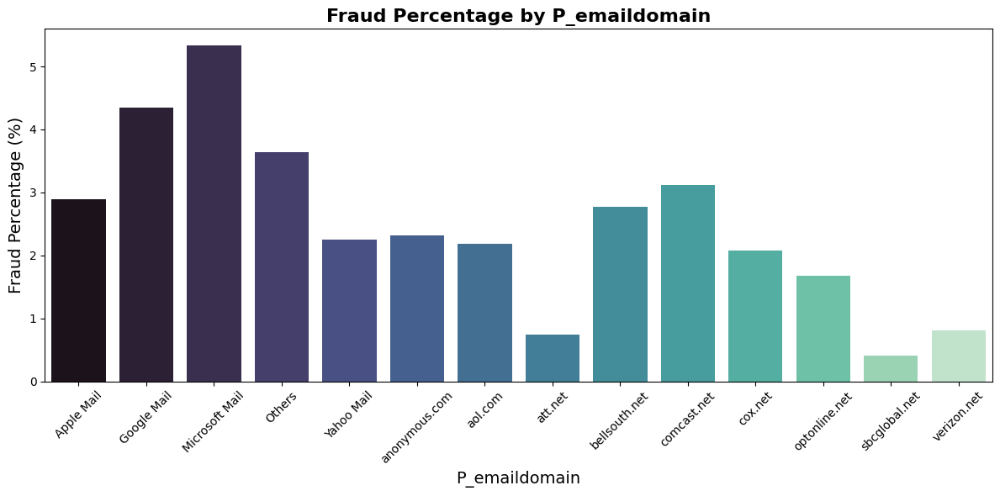

In [31]:
fraud_percentage = train_data_df.groupby('P_emaildomain')['isFraud'].mean() * 100
fraud_percentage = fraud_percentage.reset_index().rename(columns={'isFraud': 'Fraud Percentage'})


plt.figure(figsize=(12, 6))
sns.barplot(data=fraud_percentage, x='P_emaildomain', y='Fraud Percentage', palette='mako', legend=False, hue='P_emaildomain')
plt.title('Fraud Percentage by P_emaildomain', fontsize=16, fontweight='bold')
plt.xlabel('P_emaildomain', fontsize=14)
plt.ylabel('Fraud Percentage (%)', fontsize=14)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

The plot above show that the emails with highest proportion of fraudulent transactions are those coming from microsoft, google, other, yahoo, and apple. Considering this feature represents the email domain of the purchaser, it have sense that generic emails have a higher proportion of fraudulent transactions for purchases.

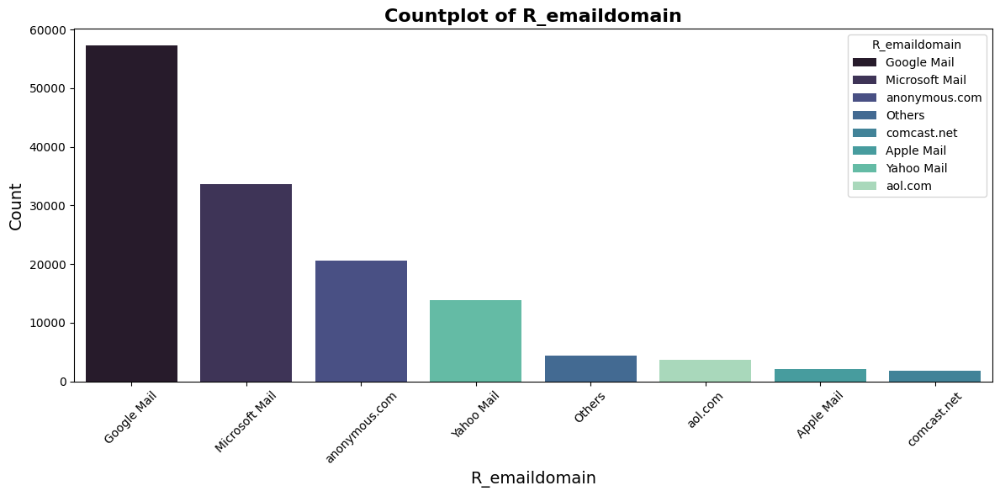

In [32]:
plt.figure(figsize=(12, 6))
sns.countplot(data=train_data_df, x='R_emaildomain', hue='R_emaildomain', palette='mako', order=train_data_df['R_emaildomain'].value_counts().index)
plt.title('Countplot of R_emaildomain', fontsize=16, fontweight='bold')
plt.xlabel('R_emaildomain', fontsize=14)
plt.ylabel('Count', fontsize=14)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

The plot above show that the emails with highest proportion of fraudulent transactions are those coming from google, microsoft, anonymous, yahoo, and other. Considering this feature represents the email domain of the recipient, it have sense the appearance of anonymous emails in the top 3.

## dist1 and dist2 analysis

The `dist1` and `dist2` features represent some distances not specified in the dataset description. 

In [37]:
nan_proportion = train_data_df['dist1'].isna().sum() / len(train_data_df)
print(nan_proportion)

0.596523520845328


We can see a big proportion of missing values for both features. 

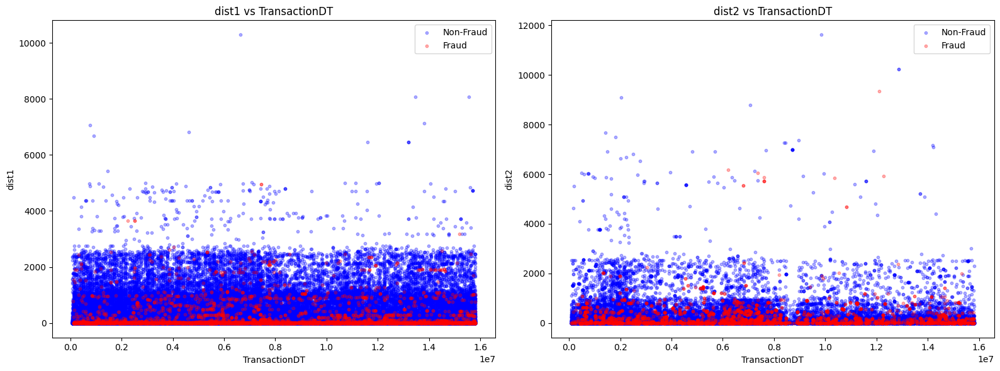

In [29]:
non_fraud = train_data_df[train_data_df['isFraud'] == 0]
fraud = train_data_df[train_data_df['isFraud'] == 1]

# Create 2x1 subplots
fig, axs = plt.subplots(1, 2, figsize=(16, 6))

# Scatter plot for dist1 vs TransactionDT
axs[0].scatter(non_fraud['TransactionDT'], non_fraud['dist1'], alpha=0.3, color='blue', label='Non-Fraud', s=10)
axs[0].scatter(fraud['TransactionDT'], fraud['dist1'], alpha=0.3, color='red', label='Fraud', s=10)
axs[0].set_title('dist1 vs TransactionDT')
axs[0].set_xlabel('TransactionDT')
axs[0].set_ylabel('dist1')
axs[0].legend()

# Scatter plot for dist2 vs TransactionDT
axs[1].scatter(non_fraud['TransactionDT'], non_fraud['dist2'], alpha=0.3, color='blue', label='Non-Fraud', s=10)
axs[1].scatter(fraud['TransactionDT'], fraud['dist2'], alpha=0.3, color='red', label='Fraud', s=10)
axs[1].set_title('dist2 vs TransactionDT')
axs[1].set_xlabel('TransactionDT')
axs[1].set_ylabel('dist2')
axs[1].legend()

plt.tight_layout()
plt.show()

We can identify some outliers in the `dist1` feature, with values above 6000, and for the `dist2` feature, with values above 8000.

In [30]:
filtered_train_data_df = train_data_df[(train_data_df['dist1'] < 6000) | (train_data_df['dist2'] < 8000)]

In [38]:
def plot_distribution(data, feature, title, ax):
    mean_val = data[feature].mean()
    median_val = data[feature].median()
    std_val = data[feature].std()

    sns.histplot(data[feature].dropna(), bins=100, alpha=0.75, color='blue', label='Non-Fraud')
    ax.axvline(mean_val, color='red', linestyle='dashed', linewidth=1, label=f'Mean: ${mean_val:.2f}')
    ax.axvline(median_val, color='green', linestyle='dashed', linewidth=1, label=f'Median: ${median_val:.2f}')
    ax.axvline(mean_val + std_val, color='blue', linestyle='dashed', linewidth=1, label=f'Std Dev: ${std_val:.2f}')
    ax.axvline(mean_val - std_val, color='blue', linestyle='dashed', linewidth=1)
    ax.set_title(title)
    ax.set_xlabel(feature)
    ax.set_ylabel('Frequency')
    ax.legend()

In [47]:
def add_stat_lines(ax, data, column, label_prefix):
    mean_val = data[column].mean()
    median_val = data[column].median()
    std_val = data[column].std()
    
    ax.axvline(mean_val, color='r', linestyle='--', linewidth=1, label=f'{label_prefix} Mean: {mean_val:.2f}')
    ax.axvline(median_val, color='g', linestyle='-', linewidth=1, label=f'{label_prefix} Median: {median_val:.2f}')
    ax.axvline(mean_val + std_val, color='b', linestyle='--', linewidth=1, label=f'{label_prefix} Std Dev: {std_val:.2f}')
    ax.axvline(mean_val - std_val, color='b', linestyle='--', linewidth=1)
    ax.legend()

def plot_histograms(data, column, title, axes, row, col):
    sns.histplot(data=data, x=column, bins=100, kde=True, ax=axes[row, col])
    axes[row, col].set_title(f'{title}: Distribution of {column}', fontsize=16, fontweight='bold')
    axes[row, col].set_xlabel(column, fontsize=14)
    axes[row, col].set_ylabel('Frequency', fontsize=14)
    add_stat_lines(axes[row, col], data, column, title)
    

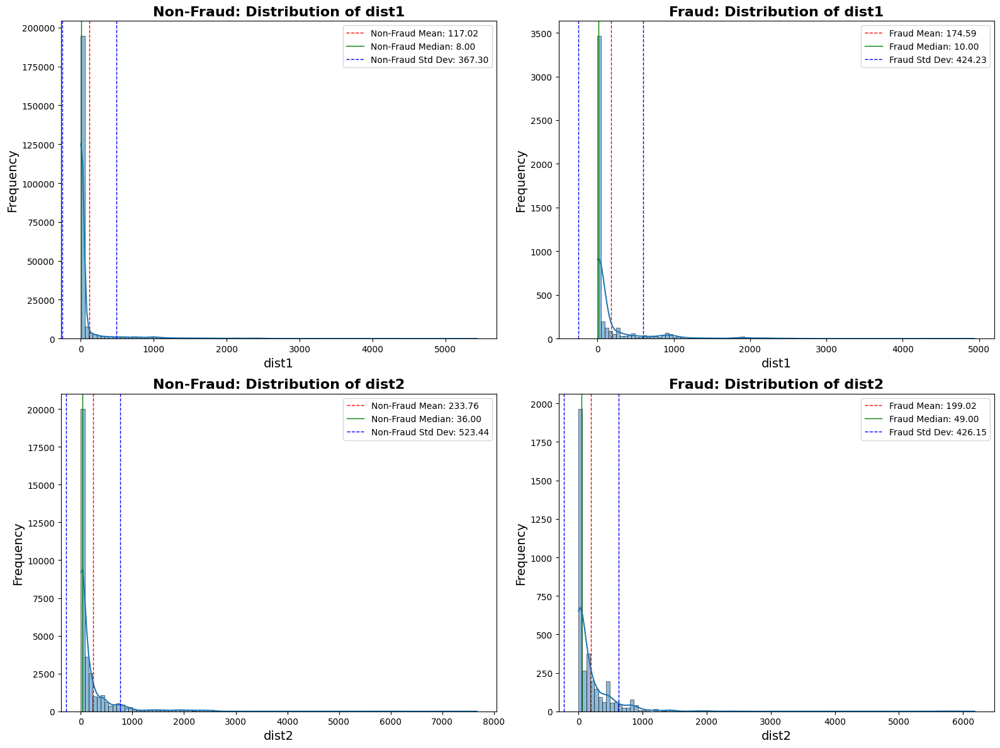

In [48]:
non_fraud = filtered_train_data_df[filtered_train_data_df['isFraud'] == 0]
fraud = filtered_train_data_df[filtered_train_data_df['isFraud'] == 1]

fig, axes = plt.subplots(2, 2, figsize=(16, 12))

plot_histograms(non_fraud, 'dist1', 'Non-Fraud', axes, 0, 0)
plot_histograms(fraud, 'dist1', 'Fraud', axes, 0, 1)

plot_histograms(non_fraud, 'dist2', 'Non-Fraud', axes, 1, 0)
plot_histograms(fraud, 'dist2', 'Fraud', axes, 1, 1)

# Adjust layout
plt.tight_layout()
plt.show()

## C1 - C14 features analysis

In [8]:
c_cols = ['C' + str(i) for i in range(1, 15)]

summary = train_data_df[c_cols].describe()
missing_values = train_data_df[c_cols].isnull().sum()
summary.loc['missing'] = missing_values
summary

,C1,C2,C3,C4,C5,C6,C7,C8,C9,C10,C11,C12,C13,C14
count,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000,590540.000000
mean,14.092458,15.269734,0.005644,4.092185,5.571526,9.071082,2.848478,5.144574,4.480240,5.240343,10.241521,4.076227,32.539918,8.295215
std,133.569018,154.668899,0.150536,68.848459,25.786976,71.508467,61.727304,95.378574,16.674897,95.581443,94.336292,86.666218,129.364844,49.544262
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,1.000000,1.000000
50%,1.000000,1.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,1.000000,0.000000,1.000000,0.000000,3.000000,1.000000
75%,3.000000,3.000000,0.000000,0.000000,1.000000,2.000000,0.000000,0.000000,2.000000,0.000000,2.000000,0.000000,12.000000,2.000000
max,4685.000000,5691.000000,26.000000,2253.000000,349.000000,2253.000000,2255.000000,3331.000000,210.000000,3257.000000,3188.000000,3188.000000,2918.000000,1429.000000
missing,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


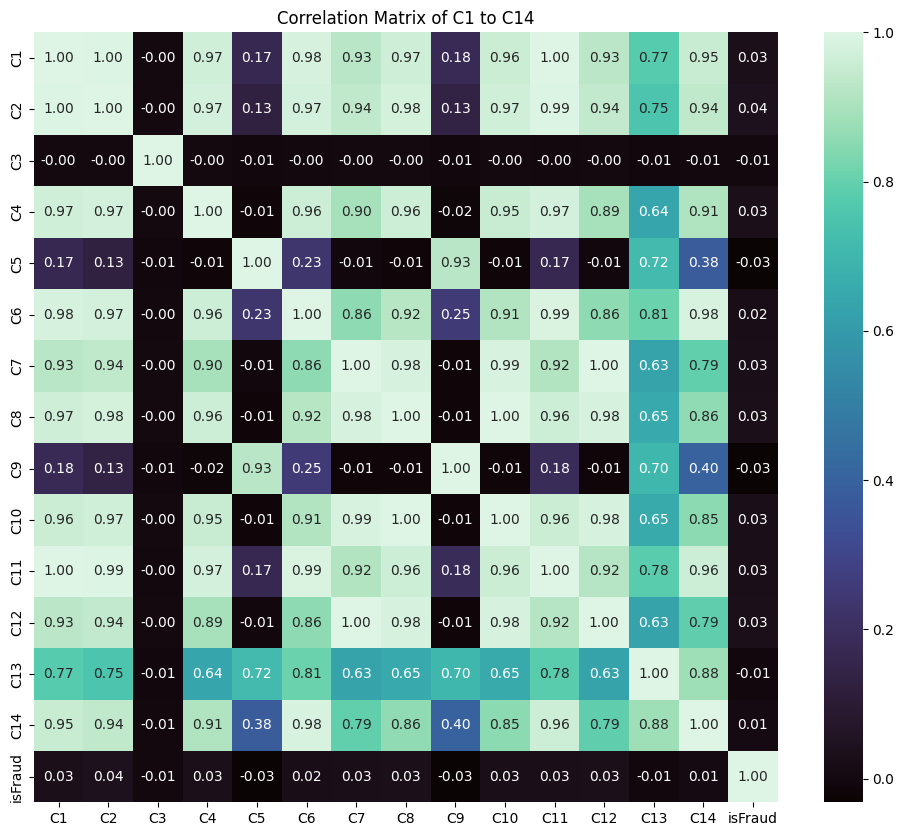

In [56]:
data =  train_data_df[c_cols + ['isFraud']]

correlation_matrix = data.corr()

plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='mako', fmt='.2f')
plt.title('Correlation Matrix of C1 to C14')
plt.show()

In [58]:
# Select pairs with correlation greater than 0.9
high_corr_pairs = correlation_matrix[(correlation_matrix.abs() > 0.9) & (correlation_matrix.abs() < 1)].stack().reset_index()
high_corr_pairs.columns = ['Feature1', 'Feature2', 'Correlation']

# Remove duplicate pairs
high_corr_pairs['OrderedPair'] = high_corr_pairs.apply(lambda x: tuple(sorted((x['Feature1'], x['Feature2']))), axis=1)
high_corr_pairs = high_corr_pairs.drop_duplicates('OrderedPair').drop(columns='OrderedPair')

# Display high correlation pairs
print(high_corr_pairs)

   Feature1 Feature2  Correlation
0        C1       C2     0.995089
1        C1       C4     0.967800
2        C1       C6     0.982238
3        C1       C7     0.926258
4        C1       C8     0.967746
5        C1      C10     0.958202
6        C1      C11     0.996515
7        C1      C12     0.927939
8        C1      C14     0.951761
10       C2       C4     0.972134
11       C2       C6     0.974845
12       C2       C7     0.938867
13       C2       C8     0.975863
14       C2      C10     0.970624
15       C2      C11     0.993898
16       C2      C12     0.940258
17       C2      C14     0.936148
20       C4       C6     0.962319
21       C4       C8     0.959995
22       C4      C10     0.952466
23       C4      C11     0.974547
24       C4      C14     0.907676
25       C5       C9     0.925786
29       C6       C8     0.921972
30       C6      C10     0.914440
31       C6      C11     0.991105
32       C6      C14     0.984201
35       C7       C8     0.982983
36       C7   

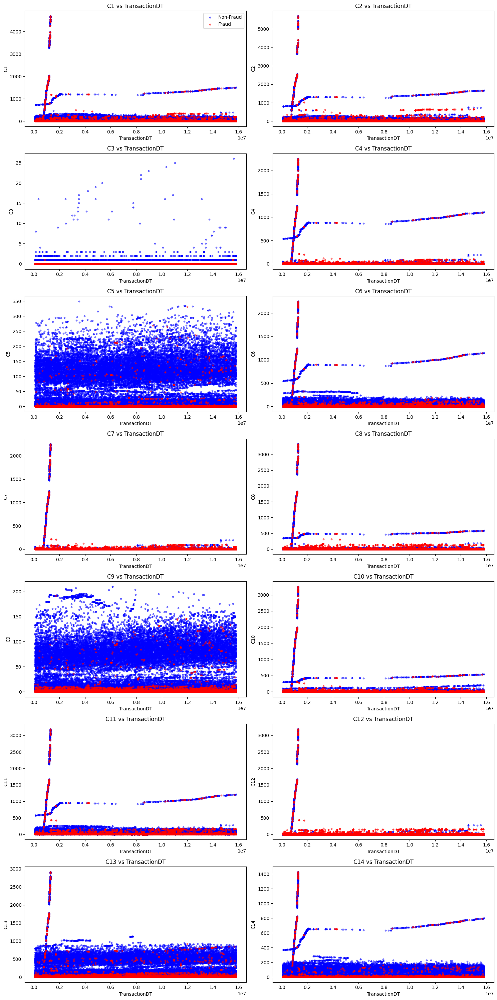

In [25]:
data = train_data_df[ c_cols + ['TransactionDT'] + ['isFraud'] ]

fig, axes = plt.subplots(7, 2, figsize=(15, 30))

axes = axes.flatten()

colors = {0: 'blue', 1: 'red'}

for i, col in enumerate(c_cols):
    fraud_data = data[data['isFraud'] == 1]
    non_fraud_data = data[data['isFraud'] == 0]
    axes[i].scatter(non_fraud_data['TransactionDT'], non_fraud_data[col], c='blue', label='Non-Fraud', alpha=0.5, s=10)
    axes[i].scatter(fraud_data['TransactionDT'], fraud_data[col], c='red', label='Fraud', alpha=0.5, s=10)
    axes[i].set_title(f'{col} vs TransactionDT')
    axes[i].set_xlabel('TransactionDT')
    axes[i].set_ylabel(col)
    if i == 0:
        axes[i].legend()

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

## D1 - D15 features analysis

According to the dataset description and competition discussions, the `D` features represent time deltas. 

In [30]:
d_cols = ['D' + str(i) for i in range(1, 16)]

summary = train_data_df[d_cols].describe()
missing_values = train_data_df[d_cols].isnull().sum()
summary.loc['missing'] = missing_values
summary

,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15
count,589271.000000,309743.000000,327662.000000,421618.000000,280699.000000,73187.000000,38917.000000,74926.000000,74926.000000,514518.000000,311253.000000,64717.000000,61952.000000,62187.000000,501427.000000
mean,94.347568,169.563231,28.343348,140.002441,42.335965,69.805717,41.638950,146.058108,0.561057,123.982137,146.621465,54.037533,17.901295,57.724444,163.744579
std,157.660387,177.315865,62.384721,191.096774,89.000144,143.669253,99.743264,231.663840,0.316880,182.615225,186.042622,124.274558,67.614425,136.312450,202.726660
min,0.000000,0.000000,0.000000,-122.000000,0.000000,-83.000000,0.000000,0.000000,0.000000,0.000000,-53.000000,-83.000000,0.000000,-193.000000,-83.000000
25%,0.000000,26.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.958333,0.208333,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,3.000000,97.000000,8.000000,26.000000,10.000000,0.000000,0.000000,37.875000,0.666666,15.000000,43.000000,0.000000,0.000000,0.000000,52.000000
75%,122.000000,276.000000,27.000000,253.000000,32.000000,40.000000,17.000000,187.958328,0.833333,197.000000,274.000000,13.000000,0.000000,2.000000,314.000000
max,640.000000,640.000000,819.000000,869.000000,819.000000,873.000000,843.000000,1707.791626,0.958333,876.000000,670.000000,648.000000,847.000000,878.000000,879.000000
missing,1269.000000,280797.000000,262878.000000,168922.000000,309841.000000,517353.000000,551623.000000,515614.000000,515614.000000,76022.000000,279287.000000,525823.000000,528588.000000,528353.000000,89113.000000


As we can see, a for a considerable number of features, there is a high proportion of missing values.

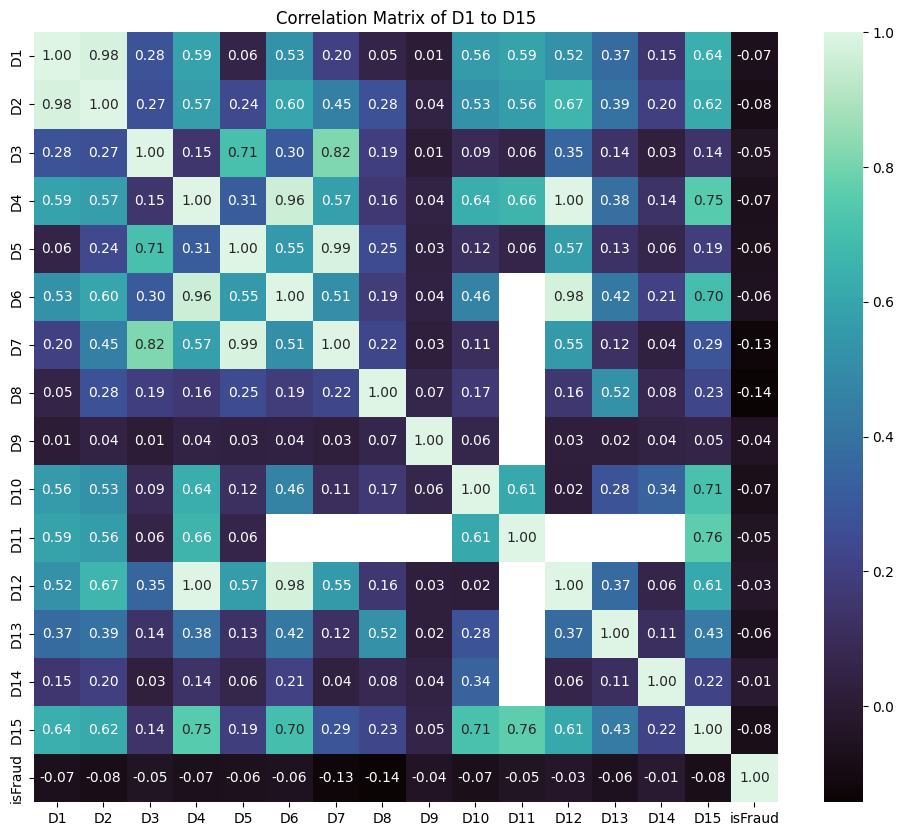

In [31]:
data =  train_data_df[d_cols + ['isFraud']]

correlation_matrix = data.corr()

plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='mako', fmt='.2f')
plt.title('Correlation Matrix of D1 to D15')
plt.show()

In [33]:
# Select pairs with correlation greater than 0.9
high_corr_pairs = correlation_matrix[(correlation_matrix.abs() > 0.8) & (correlation_matrix.abs() < 1)].stack().reset_index()
high_corr_pairs.columns = ['Feature1', 'Feature2', 'Correlation']

# Remove duplicate pairs
high_corr_pairs['OrderedPair'] = high_corr_pairs.apply(lambda x: tuple(sorted((x['Feature1'], x['Feature2']))), axis=1)
high_corr_pairs = high_corr_pairs.drop_duplicates('OrderedPair').drop(columns='OrderedPair')

# Display high correlation pairs
print(high_corr_pairs)

  Feature1 Feature2  Correlation
0       D1       D2     0.981311
2       D3       D7     0.818080
3       D4       D6     0.956966
4       D4      D12     0.999999
5       D5       D7     0.986496
7       D6      D12     0.976834


We can see a very high correlation between some of the `D` features.

/tmp/ipykernel_81008/2227515651.py:23: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/home/chris/tp_final_amq1_fraud_dataset/venv/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


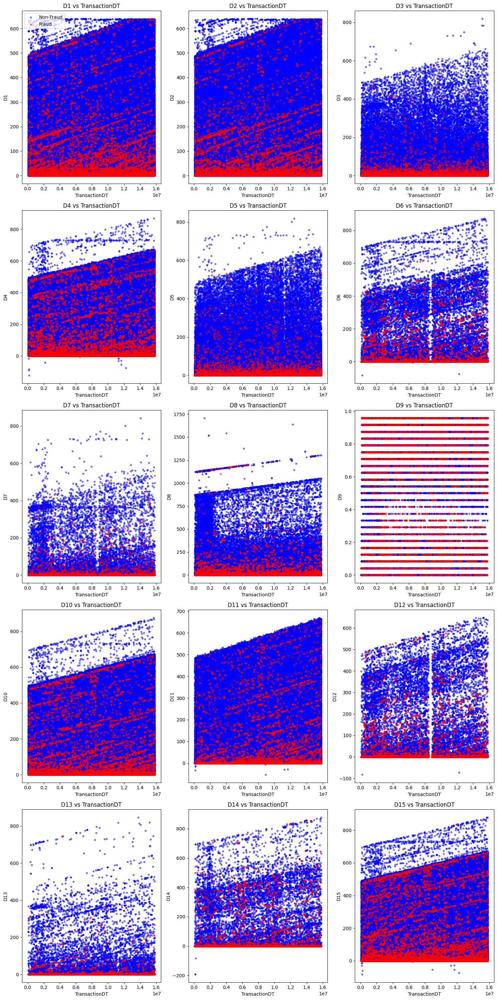

In [35]:
data = train_data_df[ d_cols + ['TransactionDT'] + ['isFraud'] ]

fig, axes = plt.subplots(5, 3, figsize=(15, 30))

axes = axes.flatten()

colors = {0: 'blue', 1: 'red'}

for i, col in enumerate(d_cols):
    fraud_data = data[data['isFraud'] == 1]
    non_fraud_data = data[data['isFraud'] == 0]
    axes[i].scatter(non_fraud_data['TransactionDT'], non_fraud_data[col], c='blue', label='Non-Fraud', alpha=0.5, s=10)
    axes[i].scatter(fraud_data['TransactionDT'], fraud_data[col], c='red', label='Fraud', alpha=0.5, s=10)
    axes[i].set_title(f'{col} vs TransactionDT')
    axes[i].set_xlabel('TransactionDT')
    axes[i].set_ylabel(col)
    if i == 0:
        axes[i].legend()

for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

## M1 - M9 features analysis

The dataset description indicates that the `M` features represent match, such as names on card and address, etc.

In [17]:
m_cols = ['M' + str(i) for i in range(1, 10)]
summary = train_data_df[m_cols].describe()
missing_values = train_data_df[m_cols].isnull().sum()
summary.loc['missing'] = missing_values
missing_percentage = round((missing_values / len(train_data_df)) * 100, 2)
summary.loc['missing_percentage'] = missing_percentage

summary

,M1,M2,M3,M4,M5,M6,M7,M8,M9
count,319440,319440,319440,309096,240058,421180,244275,244288,244288
unique,2,2,2,3,2,2,2,2,2
top,T,T,T,M0,F,F,F,F,T
freq,319415,285468,251731,196405,132491,227856,211374,155251,205656
missing,271100,271100,271100,281444,350482,169360,346265,346252,346252
missing_percentage,45.91,45.91,45.91,47.66,59.35,28.68,58.64,58.63,58.63


In [7]:
train_data_df[m_cols]

,M1,M2,M3,M4,M5,M6,M7,M8,M9
0,T,T,T,M2,F,T,NaN,NaN,NaN
1,NaN,NaN,NaN,M0,T,T,NaN,NaN,NaN
2,T,T,T,M0,F,F,F,F,F
3,NaN,NaN,NaN,M0,T,F,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
590535,T,T,T,M0,T,F,F,F,T
590536,T,F,F,M0,F,T,F,F,F
590537,T,F,F,NaN,NaN,T,NaN,NaN,NaN
590538,T,T,T,M0,F,T,NaN,NaN,NaN


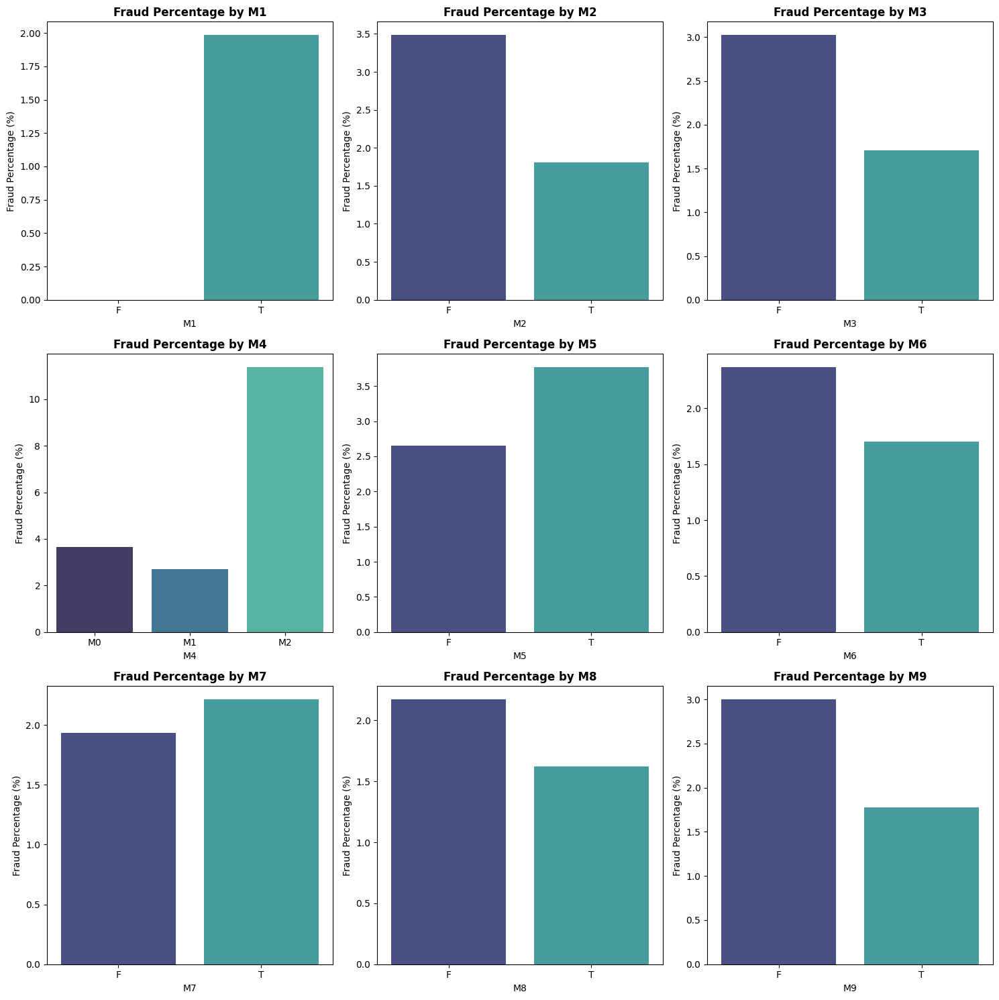

In [15]:
# Set up the matplotlib figure
fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(15, 15))
axes = axes.flatten()

for idx, col in enumerate(m_cols):
    fraud_percentage = train_data_df.groupby(col)['isFraud'].mean() * 100
    fraud_percentage = fraud_percentage.reset_index().rename(columns={'isFraud': 'Fraud Percentage'})
    
    sns.barplot(data=fraud_percentage, x=col, y='Fraud Percentage', palette='mako', ax=axes[idx], legend=False, hue=col)
    axes[idx].set_title(f'Fraud Percentage by {col}', fontsize=12, fontweight='bold')
    axes[idx].set_xlabel(col, fontsize=10)
    axes[idx].set_ylabel('Fraud Percentage (%)', fontsize=10)

plt.tight_layout()
plt.show()

# V1 - V339 features analysis

Features `V1` to `V339` are describes as Vesta engineered rich features, including ranking, counting, and other entity relations.

In [35]:
v_cols = ['V' + str(i) for i in range(1, 340)]
summary = train_data_df[v_cols].describe()
missing_values = train_data_df[v_cols].isnull().sum()
summary.loc['missing'] = missing_values
missing_percentage = round((missing_values / len(train_data_df)) * 100, 2)
summary.loc['missing_percentage'] = missing_percentage

summary

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
count,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,311253.000000,...,82351.000000,82351.000000,82351.000000,82351.000000,82351.000000,82351.00000,82351.000000,82351.000000,82351.000000,82351.000000
mean,0.999945,1.045204,1.078075,0.846456,0.876991,1.045686,1.072870,1.027704,1.041529,0.463915,...,0.775874,721.741883,1375.783644,1014.622782,9.807015,59.16455,28.530903,55.352422,151.160542,100.700882
std,0.007390,0.240133,0.320890,0.440053,0.475902,0.239385,0.304779,0.186069,0.226339,0.521522,...,4.727971,6217.223583,11169.275702,7955.735482,243.861391,387.62948,274.576920,668.486833,1095.034387,814.946722
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
50%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
75%,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,25.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
max,1.000000,8.000000,9.000000,6.000000,6.000000,9.000000,9.000000,8.000000,8.000000,4.000000,...,55.000000,160000.000000,160000.000000,160000.000000,55125.000000,55125.00000,55125.000000,104060.000000,104060.000000,104060.000000
missing,279287.000000,279287.000000,279287.000000,279287.000000,279287.000000,279287.000000,279287.000000,279287.000000,279287.000000,279287.000000,...,508189.000000,508189.000000,508189.000000,508189.000000,508189.000000,508189.00000,508189.000000,508189.000000,508189.000000,508189.000000
missing_percentage,47.290000,47.290000,47.290000,47.290000,47.290000,47.290000,47.290000,47.290000,47.290000,47.290000,...,86.050000,86.050000,86.050000,86.050000,86.050000,86.05000,86.050000,86.050000,86.050000,86.050000


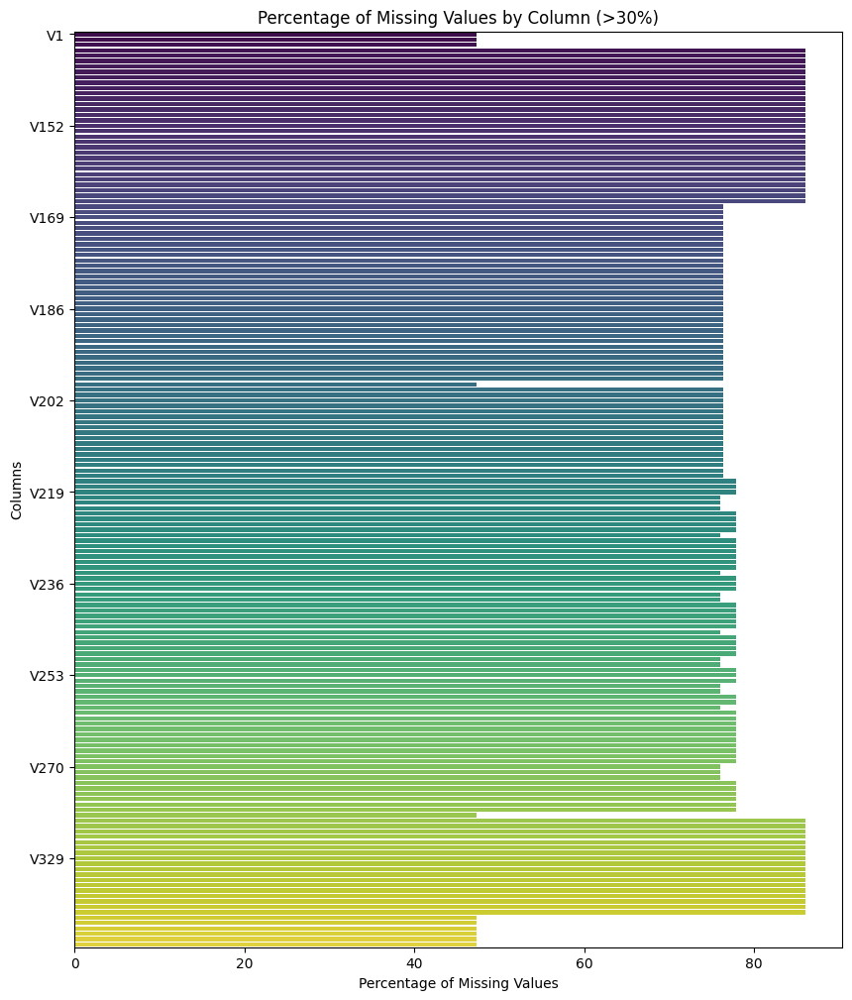

In [36]:
missing_values = train_data_df[v_cols].isnull().sum()
missing_percentage = (missing_values / len(train_data_df)) * 100

missing_percentage = missing_percentage[missing_percentage > 30]

missing_percentage = missing_percentage.sort_index()

plt.figure(figsize=(10, 12))
ax = sns.barplot(y=missing_percentage.index, x=missing_percentage.values, palette='viridis', legend=False, hue=missing_percentage.index)
plt.title('Percentage of Missing Values by Column (>30%)')
plt.xlabel('Percentage of Missing Values')
plt.ylabel('Columns')

num_labels = len(missing_percentage)
step = max(1, num_labels // 10)  
ax.set_yticks(range(0, num_labels, step))
ax.set_yticklabels(missing_percentage.index[::step])

plt.show()

As it can be seen, there is a high proportion of missing values for most of the features.

/home/chris/tp_final_amq1_fraud_dataset/venv/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


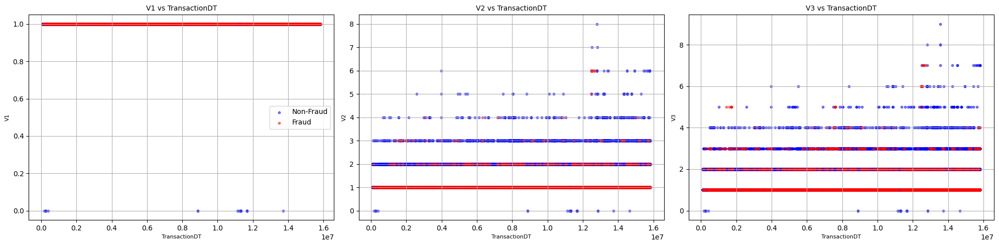

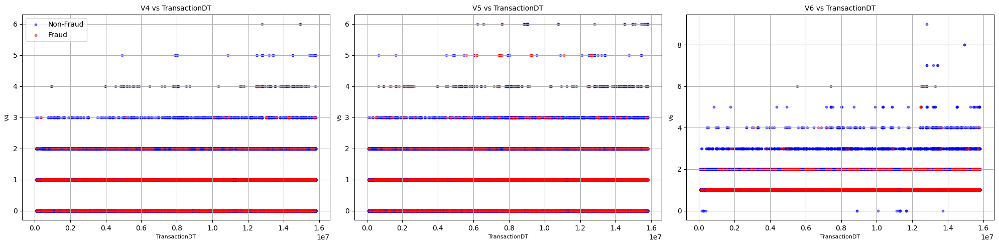

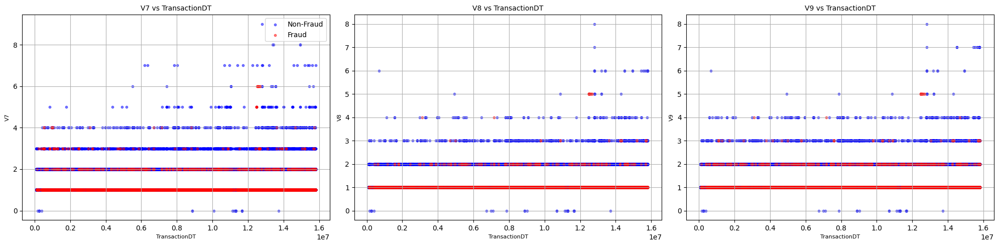

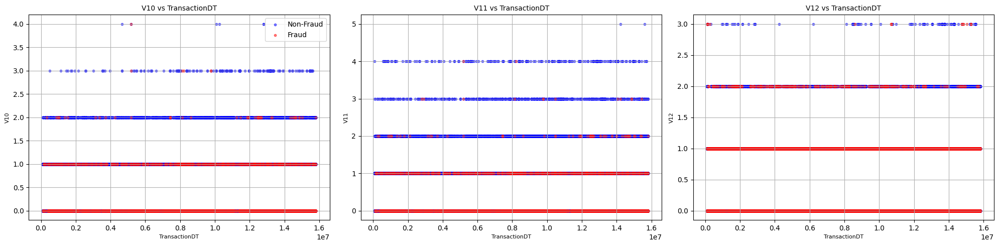

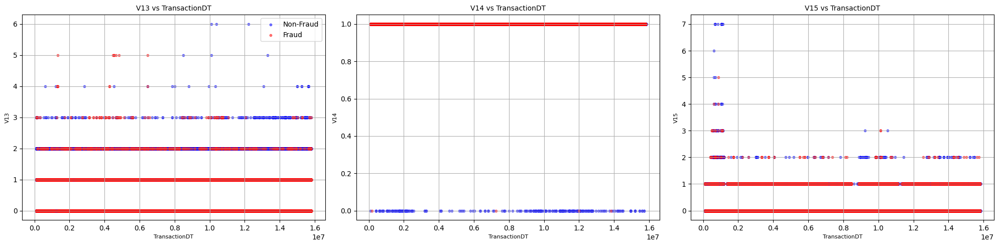

...

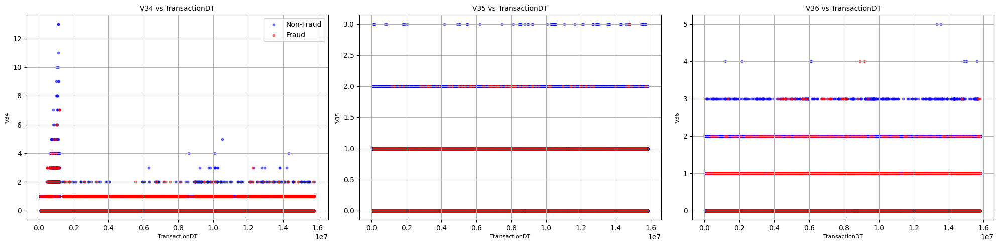

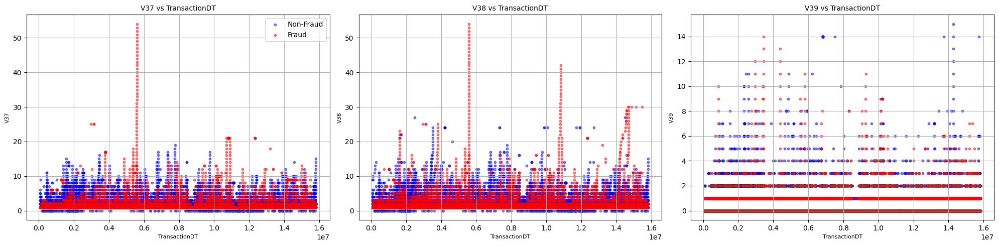

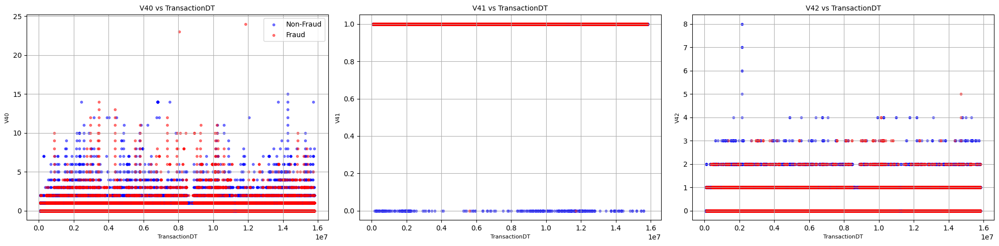

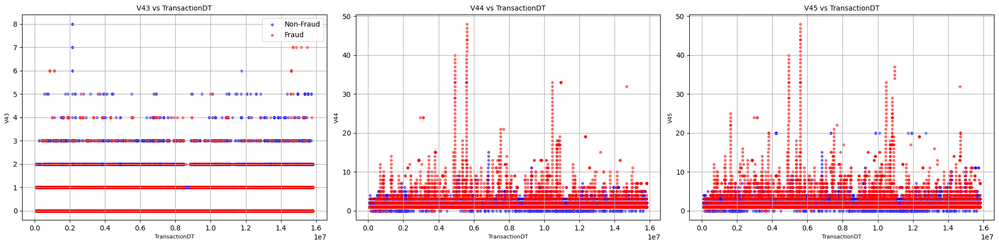

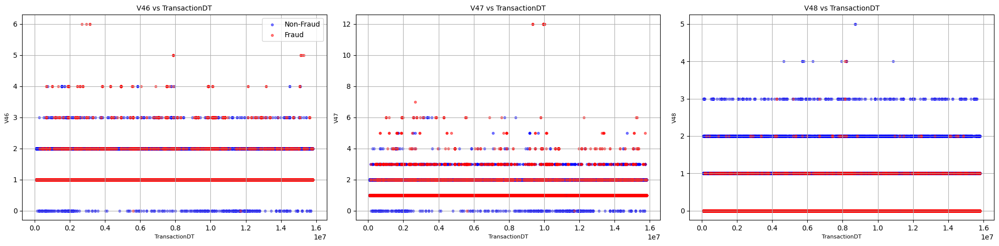

/tmp/ipykernel_2802/179057796.py:30: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()


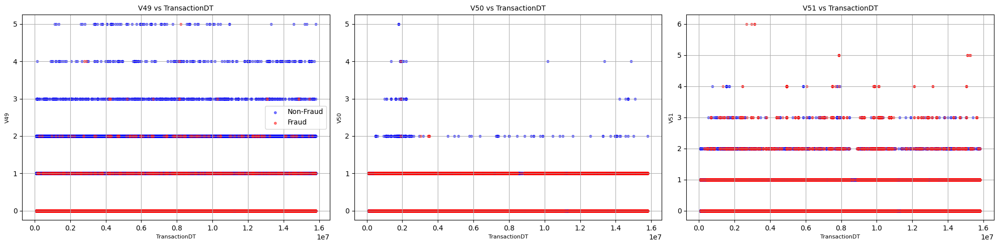

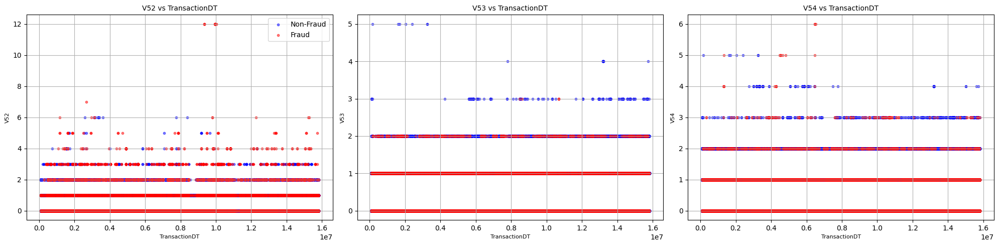

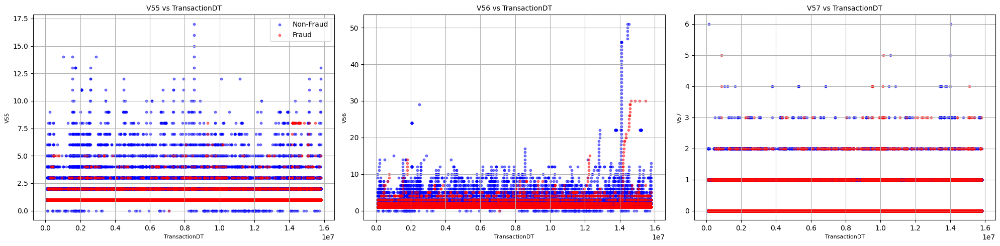

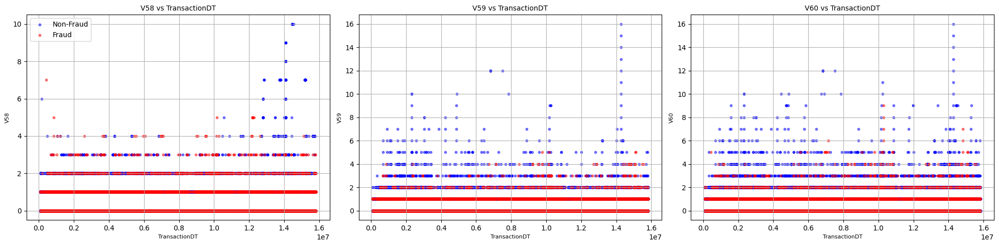

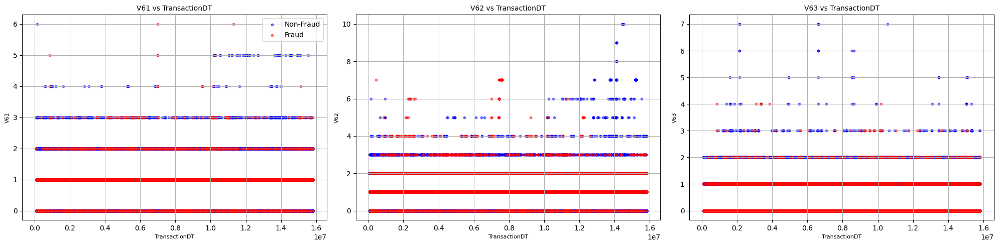

...

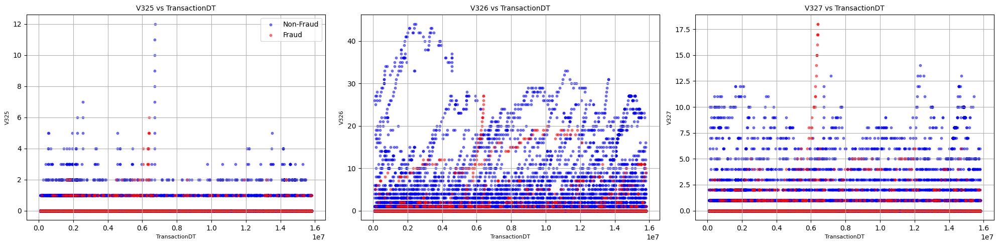

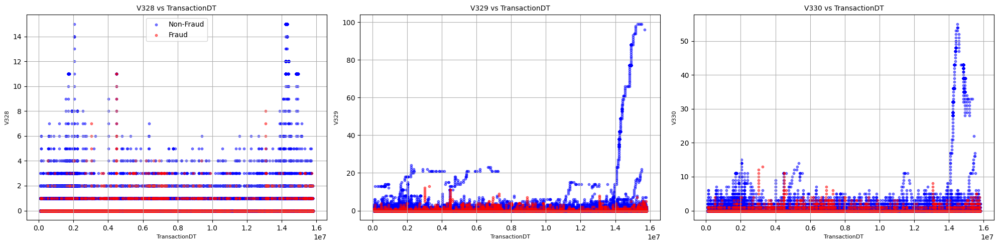

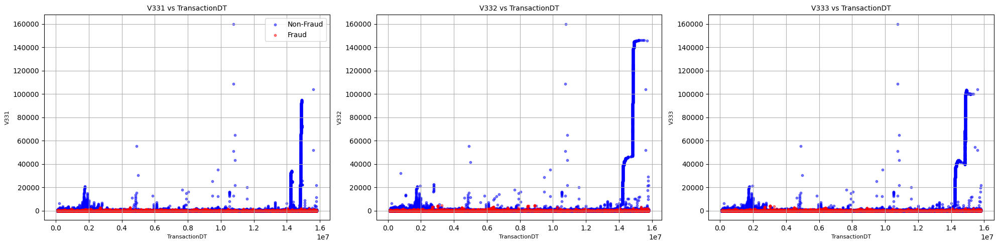

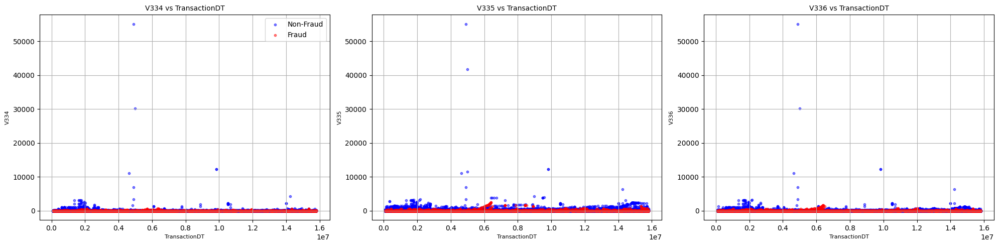

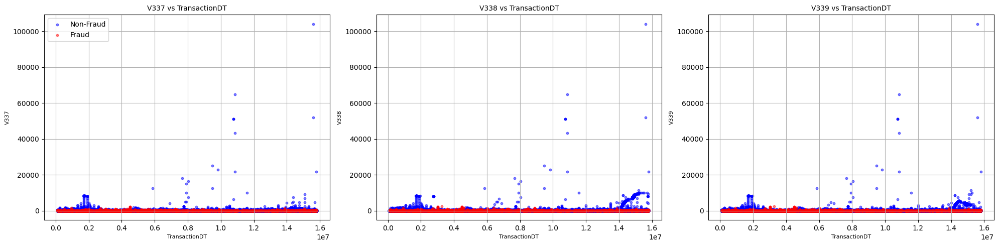

In [42]:
# Filter data to include only V columns, TransactionDT, and isFraud
data = train_data_df[v_cols + ['TransactionDT', 'isFraud']]

# Split v_cols into chunks of 3
chunks = [v_cols[i:i + 3] for i in range(0, len(v_cols), 3)]

colors = {0: 'blue', 1: 'red'}

# Plot each chunk in a 1x3 grid
for chunk in chunks:
    fig, axes = plt.subplots(1, 3, figsize=(20, 5))
    axes = axes.flatten()
    
    for i, col in enumerate(chunk):
        fraud_data = data[data['isFraud'] == 1]
        non_fraud_data = data[data['isFraud'] == 0]
        axes[i].scatter(non_fraud_data['TransactionDT'], non_fraud_data[col], c='blue', label='Non-Fraud', alpha=0.5, s=10)
        axes[i].scatter(fraud_data['TransactionDT'], fraud_data[col], c='red', label='Fraud', alpha=0.5, s=10)
        axes[i].set_title(f'{col} vs TransactionDT', fontsize=10)
        axes[i].set_xlabel('TransactionDT', fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].grid(True)
        if i == 0:
            axes[i].legend()
    
    # Remove any unused subplots (if the last chunk has less than 3 columns)
    for j in range(len(chunk), 3):
        fig.delaxes(axes[j])
    
    plt.tight_layout()
    plt.show()

## Id features analysis

In [58]:
id_cols = ['id_' + str(i).zfill(2) for i in range(1, 39)]

categorical_id_cols = [col for col in id_cols if train_data_df[col].dtype == 'object']
numerical_id_cols = [col for col in id_cols if train_data_df[col].dtype != 'object']

### Numerical features

In [59]:
summary = train_data_df[numerical_id_cols].describe()
missing_values = train_data_df[numerical_id_cols].isnull().sum()
summary.loc['missing'] = missing_values
missing_percentage = round((missing_values / len(train_data_df)) * 100, 2)
summary.loc['missing_percentage'] = missing_percentage

summary

,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,id_10,...,id_17,id_18,id_19,id_20,id_21,id_22,id_24,id_25,id_26,id_32
count,144233.000000,140872.000000,66324.000000,66324.000000,136865.000000,136865.000000,5155.000000,5155.000000,74926.000000,74926.000000,...,139369.000000,45113.000000,139318.000000,139261.000000,5159.000000,5169.000000,4747.000000,5132.000000,5163.000000,77586.000000
mean,-10.170502,174716.584708,0.060189,-0.058938,1.615585,-6.698710,13.285354,-38.600388,0.091023,-0.301124,...,189.451377,14.237337,353.128174,403.882666,368.269820,16.002708,12.800927,329.608924,149.070308,26.508597
std,14.347949,159651.816856,0.598231,0.701015,5.249856,16.491104,11.384207,26.084899,0.983842,2.789446,...,30.375360,1.561302,141.095343,152.160327,198.847038,6.897665,2.372447,97.461089,32.101995,3.737502
min,-100.000000,1.000000,-13.000000,-28.000000,-72.000000,-100.000000,-46.000000,-100.000000,-36.000000,-100.000000,...,100.000000,10.000000,100.000000,100.000000,100.000000,10.000000,11.000000,100.000000,100.000000,0.000000
25%,-10.000000,67992.000000,0.000000,0.000000,0.000000,-6.000000,5.000000,-48.000000,0.000000,0.000000,...,166.000000,13.000000,266.000000,256.000000,252.000000,14.000000,11.000000,321.000000,119.000000,24.000000
50%,-5.000000,125800.500000,0.000000,0.000000,0.000000,0.000000,14.000000,-34.000000,0.000000,0.000000,...,166.000000,15.000000,341.000000,472.000000,252.000000,14.000000,11.000000,321.000000,149.000000,24.000000
75%,-5.000000,228749.000000,0.000000,0.000000,1.000000,0.000000,22.000000,-23.000000,0.000000,0.000000,...,225.000000,15.000000,427.000000,533.000000,486.500000,14.000000,15.000000,371.000000,169.000000,32.000000
max,0.000000,999595.000000,10.000000,0.000000,52.000000,0.000000,61.000000,0.000000,25.000000,0.000000,...,229.000000,29.000000,671.000000,661.000000,854.000000,44.000000,26.000000,548.000000,216.000000,32.000000
missing,446307.000000,449668.000000,524216.000000,524216.000000,453675.000000,453675.000000,585385.000000,585385.000000,515614.000000,515614.000000,...,451171.000000,545427.000000,451222.000000,451279.000000,585381.000000,585371.000000,585793.000000,585408.000000,585377.000000,512954.000000
missing_percentage,75.580000,76.150000,88.770000,88.770000,76.820000,76.820000,99.130000,99.130000,87.310000,87.310000,...,76.400000,92.360000,76.410000,76.420000,99.130000,99.120000,99.200000,99.130000,99.130000,86.860000


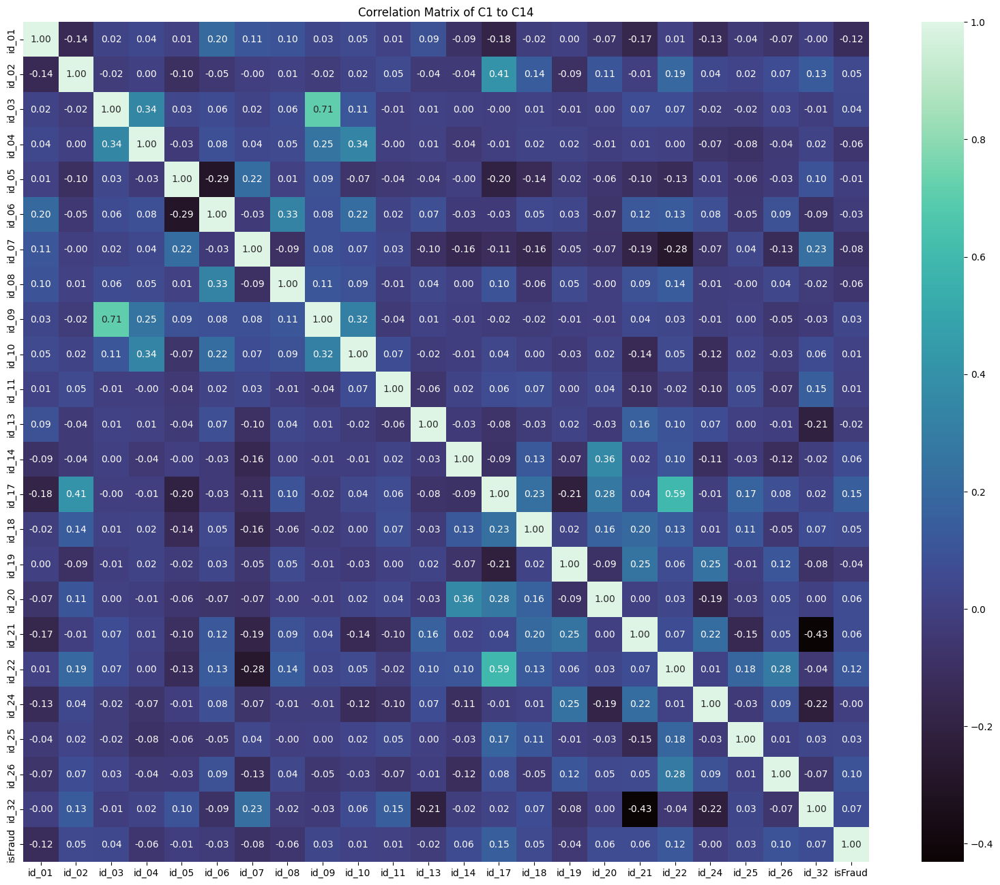

In [60]:
data =  train_data_df[numerical_id_cols + ['isFraud']]

correlation_matrix = data.corr()

plt.figure(figsize=(20, 16))
sns.heatmap(correlation_matrix, annot=True, cmap='mako', fmt='.2f')
plt.title('Correlation Matrix of C1 to C14')
plt.show()

/tmp/ipykernel_2802/3264697807.py:30: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/home/chris/tp_final_amq1_fraud_dataset/venv/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


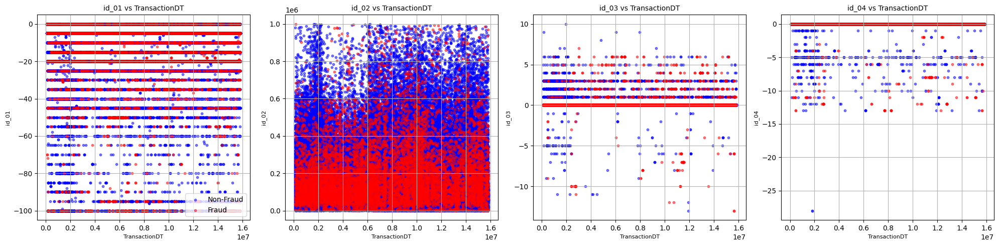

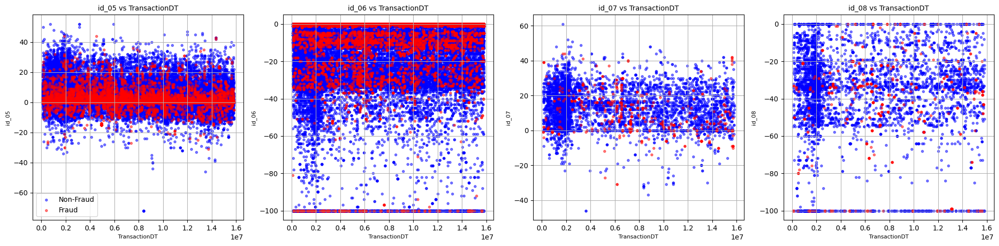

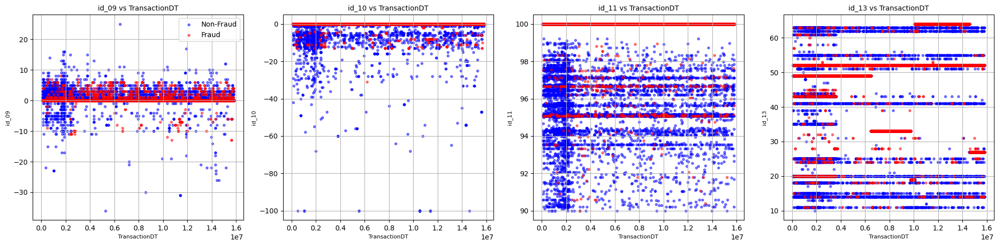

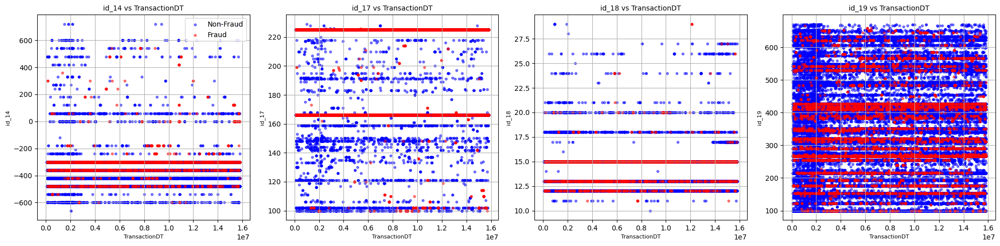

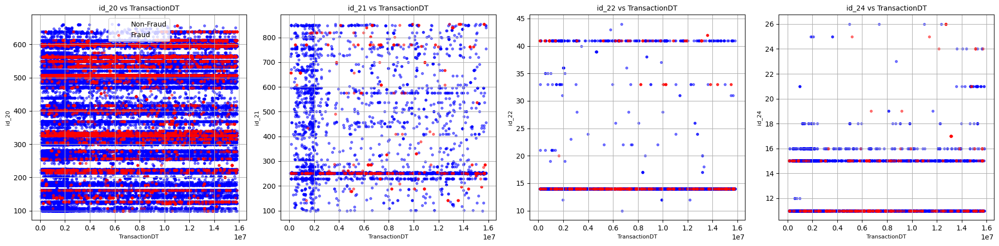

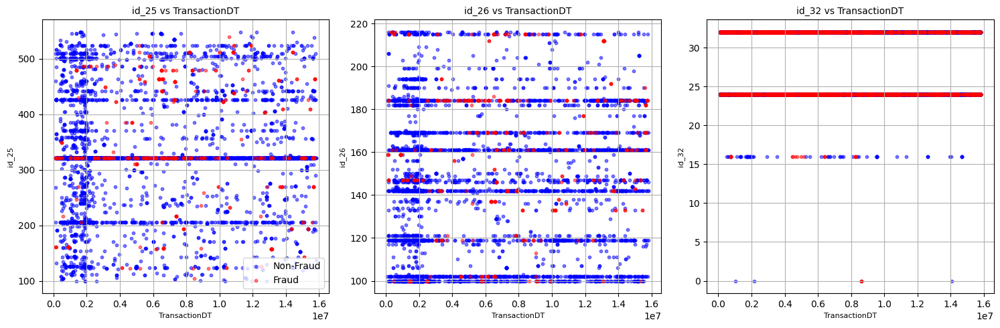

In [69]:
# Filter data to include only numerical ID columns, TransactionDT, and isFraud
data = train_data_df[numerical_id_cols + ['TransactionDT', 'isFraud']]

# Split numerical_id_cols into chunks of 3
chunks = [numerical_id_cols[i:i + 4] for i in range(0, len(numerical_id_cols), 4)]

colors = {0: 'blue', 1: 'red'}

# Plot each chunk in a 1x3 grid
for chunk in chunks:
    fig, axes = plt.subplots(1, 4, figsize=(20, 5))
    axes = axes.flatten()
    
    for i, col in enumerate(chunk):
        fraud_data = data[data['isFraud'] == 1]
        non_fraud_data = data[data['isFraud'] == 0]
        axes[i].scatter(non_fraud_data['TransactionDT'], non_fraud_data[col], c='blue', label='Non-Fraud', alpha=0.5, s=10)
        axes[i].scatter(fraud_data['TransactionDT'], fraud_data[col], c='red', label='Fraud', alpha=0.5, s=10)
        axes[i].set_title(f'{col} vs TransactionDT', fontsize=10)
        axes[i].set_xlabel('TransactionDT', fontsize=8)
        axes[i].set_ylabel(col, fontsize=8)
        axes[i].grid(True)
        if i == 0:
            axes[i].legend()
    
    # Remove any unused subplots (if the last chunk has less than 3 columns)
    for j in range(len(chunk), 4):
        fig.delaxes(axes[j])
    
    plt.tight_layout()
    plt.show()

In [73]:
summary = train_data_df[categorical_id_cols].describe()
missing_values = train_data_df[categorical_id_cols].isnull().sum()
summary.loc['missing'] = missing_values
missing_percentage = round((missing_values / len(train_data_df)) * 100, 2)
summary.loc['missing_percentage'] = missing_percentage

summary

,id_12,id_15,id_16,id_23,id_27,id_28,id_29,id_30,id_31,id_33,id_34,id_35,id_36,id_37,id_38
count,144233,140985,129340,5169,5169,140978,140978,77565,140282,73289,77805,140985,140985,140985,140985
unique,2,3,2,3,2,2,2,75,130,260,4,2,2,2,2
top,NotFound,Found,Found,IP_PROXY:TRANSPARENT,Found,Found,Found,Windows 10,chrome 63.0,1920x1080,match_status:2,T,F,T,F
freq,123025,67728,66324,3489,5155,76232,74926,21155,22000,16874,60011,77814,134066,110452,73922
missing,446307,449555,461200,585371,585371,449562,449562,512975,450258,517251,512735,449555,449555,449555,449555
missing_percentage,75.58,76.13,78.1,99.12,99.12,76.13,76.13,86.87,76.25,87.59,86.82,76.13,76.13,76.13,76.13


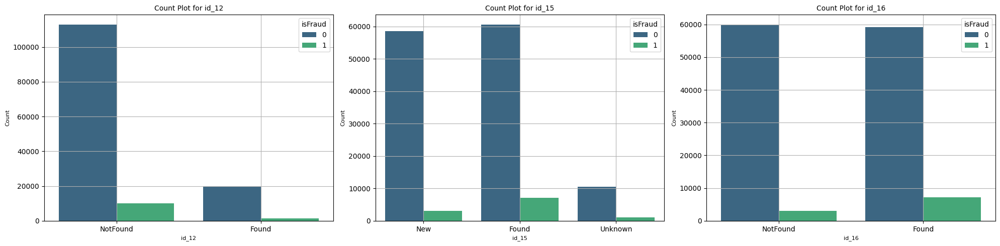

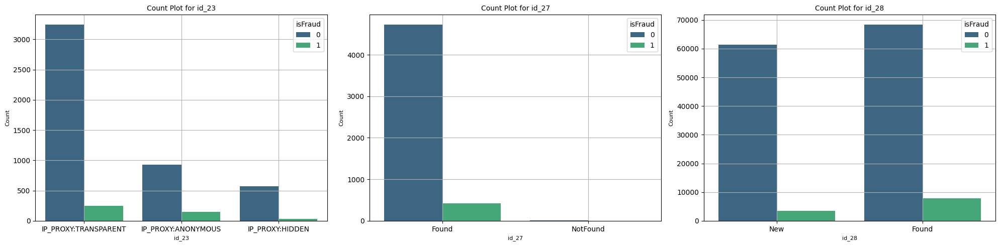

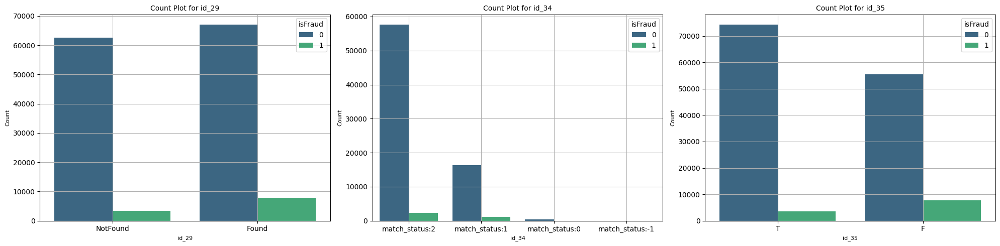

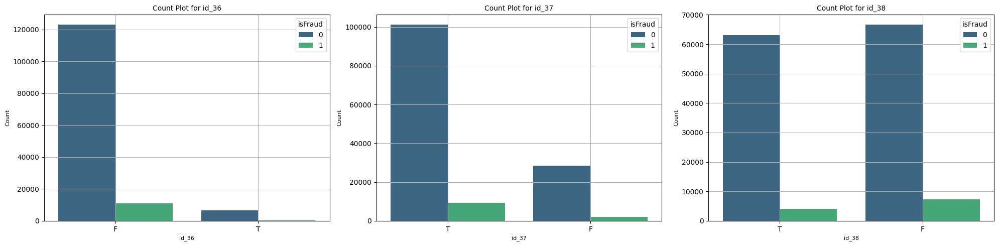

In [77]:
filtered_categorical_id_cols = [col for col in categorical_id_cols if col not in ['id_30', 'id_31', 'id_33']]

# Filter data to include only the filtered categorical columns and isFraud
data = train_data_df[filtered_categorical_id_cols + ['isFraud']]

# Split filtered_categorical_id_cols into chunks of 3
chunks = [filtered_categorical_id_cols[i:i + 3] for i in range(0, len(filtered_categorical_id_cols), 3)]

# Plot each chunk in a 1x3 grid
for chunk in chunks:
    fig, axes = plt.subplots(1, 3, figsize=(20, 5))
    axes = axes.flatten()
    
    for i, col in enumerate(chunk):
        sns.countplot(data=data, x=col, hue='isFraud', palette='viridis', ax=axes[i])
        axes[i].set_title(f'Count Plot for {col}', fontsize=10)
        axes[i].set_xlabel(col, fontsize=8)
        axes[i].set_ylabel('Count', fontsize=8)
        axes[i].grid(True)
        if i == 0:
            axes[i].legend(title='isFraud')
    
    # Remove any unused subplots (if the last chunk has less than 3 columns)
    for j in range(len(chunk), 3):
        fig.delaxes(axes[j])
    
    plt.tight_layout()
    plt.show()

In [86]:
unique_values_id_30 = train_data_df['id_30'].unique()
print(unique_values_id_30)

[nan 'Android 7.0' 'iOS 11.1.2' 'Mac OS X 10_11_6' 'Windows 10' 'Android'
 'Linux' 'iOS 11.0.3' 'Mac OS X 10_7_5' 'Mac OS X 10_12_6'
 'Mac OS X 10_13_1' 'iOS 11.1.0' 'Mac OS X 10_9_5' 'Windows 7'
 'Windows 8.1' 'Mac' 'iOS 10.3.3' 'Mac OS X 10.12' 'Mac OS X 10_10_5'
 'Mac OS X 10_11_5' 'iOS 9.3.5' 'Android 5.1.1' 'Android 7.1.1'
 'Android 6.0' 'iOS 10.3.1' 'Mac OS X 10.9' 'iOS 11.1.1' 'Windows Vista'
 'iOS 10.3.2' 'iOS 11.0.2' 'Mac OS X 10.11' 'Android 8.0.0' 'iOS 10.2.0'
 'iOS 10.2.1' 'iOS 11.0.0' 'Mac OS X 10.10' 'Mac OS X 10_12_3'
 'Mac OS X 10_12' 'Android 6.0.1' 'iOS' 'Mac OS X 10.13'
 'Mac OS X 10_12_5' 'Mac OS X 10_8_5' 'iOS 11.0.1' 'iOS 10.0.2'
 'Android 5.0.2' 'Windows XP' 'iOS 11.2.0' 'Mac OS X 10.6' 'Windows 8'
 'Mac OS X 10_6_8' 'Mac OS X 10_11_4' 'Mac OS X 10_12_1' 'iOS 10.1.1'
 'Mac OS X 10_11_3' 'Mac OS X 10_12_4' 'Mac OS X 10_13_2' 'Android 4.4.2'
 'Mac OS X 10_12_2' 'Android 5.0' 'func' 'Android 7.1.2' 'Android 8.1.0'
 'other' 'Mac OS X 10_13_3' 'iOS 11.2.1' 'iOS 11.2.5

In [87]:
mapping_id_30 = {
    'Android': 'Android',
    'iOS': 'iOS',
    'Mac OS X': 'Mac OS X',
    'Windows': 'Windows',
    'Linux': 'Linux',
    'other': 'Other',
    'func': 'Other'
}

def categorize_os(value):
    for key in mapping_id_30.keys():
        if pd.notnull(value) and key in value:
            return mapping_id_30[key]
    return value 

train_data_df['id_30'] = train_data_df['id_30'].apply(categorize_os)

unique_values_id_30_grouped = train_data_df['id_30'].unique()
print(unique_values_id_30_grouped)

[nan 'Android' 'iOS' 'Mac OS X' 'Windows' 'Linux' 'Mac' 'Other']


<Figure size 2400x600 with 0 Axes>

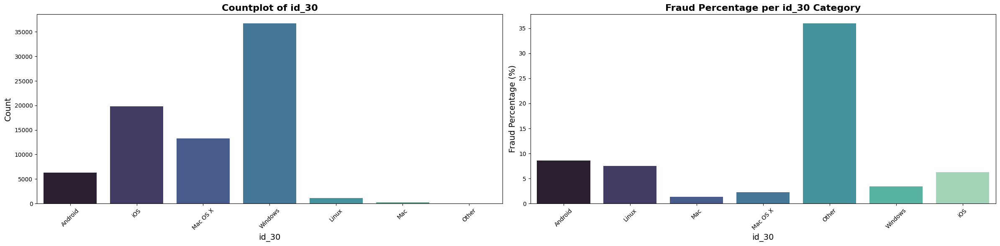

In [91]:
category_grouped = train_data_df.groupby('id_30')['isFraud'].agg(['size', 'sum'])
category_grouped['fraud_percentage'] = (category_grouped['sum'] / category_grouped['size']) * 100
category_grouped.reset_index(inplace=True)

# Plot 1: Countplot of id_30
plt.figure(figsize=(24, 6))
fig, axes = plt.subplots(1, 2, figsize=(24, 6))

sns.countplot(data=train_data_df, x='id_30', palette='mako', ax=axes[0], hue='id_30', legend=False)
axes[0].set_title('Countplot of id_30', fontsize=16, fontweight='bold')
axes[0].set_xlabel('id_30', fontsize=14)
axes[0].set_ylabel('Count', fontsize=14)
axes[0].tick_params(axis='x', rotation=45)

# Plot 2: Fraud Percentage per category
sns.barplot(data=category_grouped, x='id_30', y='fraud_percentage', ax=axes[1], palette='mako', hue='id_30', legend=False)
axes[1].set_title('Fraud Percentage per id_30 Category', fontsize=16, fontweight='bold')
axes[1].set_xlabel('id_30', fontsize=14)
axes[1].set_ylabel('Fraud Percentage (%)', fontsize=14)
axes[1].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

In [93]:
unique_values_id_30 = train_data_df['id_31'].unique()
print(unique_values_id_30)

[nan 'samsung browser 6.2' 'mobile safari 11.0' 'chrome 62.0'
 'chrome 62.0 for android' 'edge 15.0' 'mobile safari generic'
 'chrome 49.0' 'chrome 61.0' 'edge 16.0' 'safari generic' 'edge 14.0'
 'chrome 56.0 for android' 'firefox 57.0' 'chrome 54.0 for android'
 'mobile safari uiwebview' 'chrome' 'chrome 62.0 for ios' 'firefox'
 'chrome 60.0 for android' 'mobile safari 10.0' 'chrome 61.0 for android'
 'ie 11.0 for desktop' 'ie 11.0 for tablet' 'mobile safari 9.0'
 'chrome generic' 'other' 'chrome 59.0 for android' 'firefox 56.0'
 'android webview 4.0' 'chrome 55.0' 'opera 49.0' 'ie'
 'chrome 55.0 for android' 'firefox 52.0' 'chrome 57.0 for android'
 'chrome 56.0' 'chrome 46.0 for android' 'chrome 58.0' 'firefox 48.0'
 'chrome 59.0' 'samsung browser 4.0' 'edge 13.0' 'chrome 53.0 for android'
 'chrome 58.0 for android' 'chrome 60.0' 'mobile safari 8.0'
 'firefox generic' 'Generic/Android 7.0' 'mobile' 'Samsung/SM-G532M'
 'chrome 50.0 for android' 'chrome 51.0 for android' 'chrome 63.0'

In [97]:
def general_map_browser(value):
    if pd.isnull(value):
        return value  # Keep NaN values as they are
    value = value.lower()
    if 'safari' in value and 'mobile' in value:
        return 'Mobile Safari'
    elif 'safari' in value:
        return 'Safari'
    elif 'chrome' in value:
        return 'Chrome'
    elif 'firefox' in value:
        return 'Firefox'
    elif 'samsung' in value:
        return 'Samsung Browser'
    elif 'edge' in value:
        return 'Edge'
    elif 'ie' in value or 'internet explorer' in value:
        return 'Internet Explorer'
    elif 'opera' in value:
        return 'Opera'
    else:
        return 'Other'

# Apply the mapping to create a new column
train_data_df['id_31'] = train_data_df['id_31'].apply(general_map_browser)

# Check the unique values in the new column
unique_values_id_31 = train_data_df['id_31'].unique()
print(unique_values_id_31)

[nan 'Samsung Browser' 'Mobile Safari' 'Chrome' 'Edge' 'Safari' 'Firefox'
 'Internet Explorer' 'Other' 'Opera']


<Figure size 2400x600 with 0 Axes>

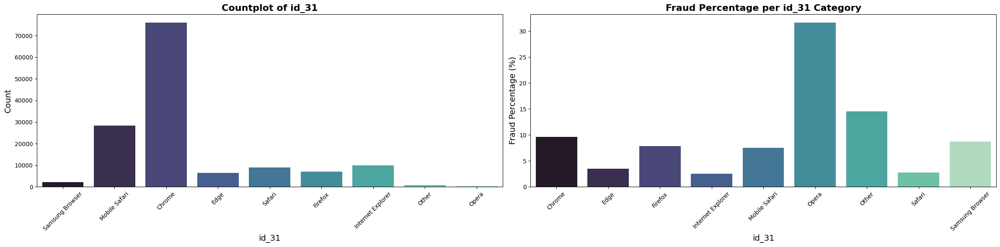

In [98]:
category_grouped = train_data_df.groupby('id_31')['isFraud'].agg(['size', 'sum'])
category_grouped['fraud_percentage'] = (category_grouped['sum'] / category_grouped['size']) * 100
category_grouped.reset_index(inplace=True)

# Plot 1: Countplot of id_31
plt.figure(figsize=(24, 6))
fig, axes = plt.subplots(1, 2, figsize=(24, 6))

sns.countplot(data=train_data_df, x='id_31', palette='mako', ax=axes[0], hue='id_31', legend=False)
axes[0].set_title('Countplot of id_31', fontsize=16, fontweight='bold')
axes[0].set_xlabel('id_31', fontsize=14)
axes[0].set_ylabel('Count', fontsize=14)
axes[0].tick_params(axis='x', rotation=45)

# Plot 2: Fraud Percentage per category
sns.barplot(data=category_grouped, x='id_31', y='fraud_percentage', ax=axes[1], palette='mako', hue='id_31', legend=False)
axes[1].set_title('Fraud Percentage per id_31 Category', fontsize=16, fontweight='bold')
axes[1].set_xlabel('id_31', fontsize=14)
axes[1].set_ylabel('Fraud Percentage (%)', fontsize=14)
axes[1].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

In [99]:
unique_values_id_33 = train_data_df['id_33'].unique()
print(unique_values_id_33)

[nan '2220x1080' '1334x750' '1280x800' '1366x768' '1920x1080' '1680x1050'
 '1136x640' '5120x2880' '2880x1800' '1920x1200' '2560x1600' '2048x1536'
 '1024x768' '1280x720' '2560x1440' '2208x1242' '2001x1125' '1440x900'
 '1600x900' '2672x1440' '1280x1024' '960x540' '2732x2048' '2436x1125'
 '2048x1152' '2960x1440' '1024x600' '855x480' '4096x2304' '2160x1440'
 '2562x1442' '801x480' '2736x1824' '3441x1440' '2880x1620' '3840x2160'
 '1638x922' '1280x768' '1360x768' '1280x960' '3440x1440' '1152x720'
 '1280x1025' '3360x2100' '2304x1296' '1152x864' '3200x1800' '2112x1188'
 '2224x1668' '2400x1350' '2000x1125' '1600x1000' '2560x1080' '1728x972'
 '3000x2000' '1024x640' '3840x2400' '2304x1440' '1280x600' '1400x1050'
 '1600x1200' '3201x1800' '1356x900' '1344x756' '1624x1080' '1536x864'
 '1800x1125' '1920x1281' '2961x1442' '1366x1024' '1344x840' '3360x1890'
 '1536x1152' '1200x675' '1480x720' '2400x1600' '3200x2000' '1281x801'
 '960x640' '1776x1000' '2048x1280' '2049x1152' '1138x640' '2160x1215'
 '2880x1

In [102]:
def discretize_resolution(value):
    if pd.isnull(value):
        return value  # Keep NaN values as they are
    
    try:
        width, height = map(int, value.split('x'))
        resolution = width * height
        
        if resolution <= 1280 * 720:
            return 'HD'
        elif resolution <= 1920 * 1080:
            return 'Full HD'
        elif resolution <= 2560 * 1440:
            return 'Quad HD'
        elif resolution <= 3840 * 2160:
            return '4K'
        else:
            return 'Higher than 4K'
    except:
        return 'Other'

# Apply the discretization to create a new column
train_data_df['id_33'] = train_data_df['id_33'].apply(discretize_resolution)

# Check the unique values in the new column
unique_values_id_33 = train_data_df['id_33'].unique()
print(unique_values_id_33)

[nan 'Quad HD' 'Full HD' 'HD' 'Higher than 4K' '4K']


<Figure size 2400x600 with 0 Axes>

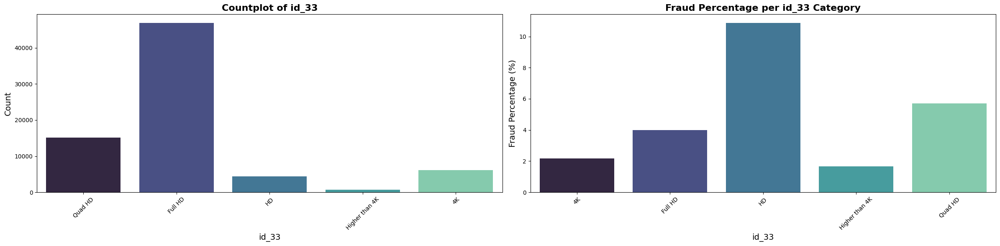

In [103]:
category_grouped = train_data_df.groupby('id_33')['isFraud'].agg(['size', 'sum'])
category_grouped['fraud_percentage'] = (category_grouped['sum'] / category_grouped['size']) * 100
category_grouped.reset_index(inplace=True)

# Plot 1: Countplot of id_33
plt.figure(figsize=(24, 6))
fig, axes = plt.subplots(1, 2, figsize=(24, 6))

sns.countplot(data=train_data_df, x='id_33', palette='mako', ax=axes[0], hue='id_33', legend=False)
axes[0].set_title('Countplot of id_33', fontsize=16, fontweight='bold')
axes[0].set_xlabel('id_33', fontsize=14)
axes[0].set_ylabel('Count', fontsize=14)
axes[0].tick_params(axis='x', rotation=45)

# Plot 2: Fraud Percentage per category
sns.barplot(data=category_grouped, x='id_33', y='fraud_percentage', ax=axes[1], palette='mako', hue='id_33', legend=False)
axes[1].set_title('Fraud Percentage per id_33 Category', fontsize=16, fontweight='bold')
axes[1].set_xlabel('id_33', fontsize=14)
axes[1].set_ylabel('Fraud Percentage (%)', fontsize=14)
axes[1].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

## Device type analysis

In [104]:
summary = train_data_df[['DeviceType']].describe()
missing_values = train_data_df[['DeviceType']].isnull().sum()
summary.loc['missing'] = missing_values
missing_percentage = round((missing_values / len(train_data_df)) * 100, 2)
summary.loc['missing_percentage'] = missing_percentage

summary

,DeviceType
count,140810
unique,2
top,desktop
freq,85165
missing,449730
missing_percentage,76.16


<Figure size 2400x600 with 0 Axes>

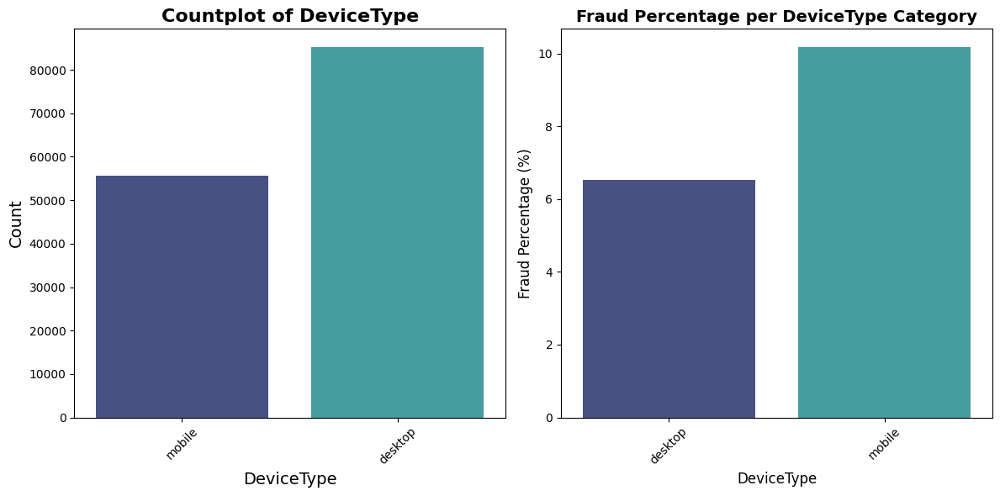

In [110]:
category_grouped = train_data_df.groupby('DeviceType')['isFraud'].agg(['size', 'sum'])
category_grouped['fraud_percentage'] = (category_grouped['sum'] / category_grouped['size']) * 100
category_grouped.reset_index(inplace=True)

# Plot 1: Countplot of DeviceType
plt.figure(figsize=(24, 6))
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

sns.countplot(data=train_data_df, x='DeviceType', palette='mako', ax=axes[0], hue='DeviceType', legend=False)
axes[0].set_title('Countplot of DeviceType', fontsize=16, fontweight='bold')
axes[0].set_xlabel('DeviceType', fontsize=14)
axes[0].set_ylabel('Count', fontsize=14)
axes[0].tick_params(axis='x', rotation=45)

# Plot 2: Fraud Percentage per category
sns.barplot(data=category_grouped, x='DeviceType', y='fraud_percentage', ax=axes[1], palette='mako', hue='DeviceType', legend=False)
axes[1].set_title('Fraud Percentage per DeviceType Category', fontsize=14, fontweight='bold')
axes[1].set_xlabel('DeviceType', fontsize=12)
axes[1].set_ylabel('Fraud Percentage (%)', fontsize=12)
axes[1].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()